In [1]:
from skykatana import SkyMaskPipe
from pathlib import Path

In [2]:
# Input hipscatted catalog
HIPCAT = "/ocean/projects/phy210048p/shared/hscmags/hscx_gal/"     # hipscatted input catalog

# Bright star, box and dip regions to mask out #######################
# See https://ui.adsabs.harvard.edu/abs/2018PASJ...70S...7C/abstract
# as well as https://jeancoupon.com/brightStarMasks
REGION_DIR    = Path('/ocean/projects/phy210048p/shared/hsc_bsregions/')
STARS_REGIONS = REGION_DIR / 'stars.reg.I.nodups.parquet' 
BOX_STARS_REGIONS   = REGION_DIR / 'box.reg.I.parquet' 
DIP_STARS_REGIONS   = REGION_DIR / 'dip.reg.I.nodups'

# HSC patches and QA patch list ###################################### 
# Parquet patches are made by /hsc_patches/extract_patch_rects.ipynb
# See https://hsc-release.mtk.nao.ac.jp/schema/#pdr3.pdr3_wide.patch_qa
PATCH_DIR     = Path('/ocean/projects/phy210048p/shared/hsc_patches/')
PATCH_1       = PATCH_DIR / 'tracts_patches_W-hectomap.parquet'
PATCH_2       = PATCH_DIR / 'tracts_patches_W-AEGIS.parquet'
PATCH_3       = PATCH_DIR / 'tracts_patches_W-autumn.parquet'
PATCH_4       = PATCH_DIR / 'tracts_patches_W-spring.parquet'
PATCH_FILE    = [PATCH_1, PATCH_2, PATCH_3, PATCH_4]
QA_FILE       = PATCH_DIR / 'patch_qa.csv'

# Extended sources to mask out
ELLIP_REGIONS = '../data/hsc_aux/extended_sources.txt'

# User defined masks
USER_CIRCLE_REGIONS = '../data/hsc_aux/user_circs.txt' 
USER_POLY_REGIONS   = '../data/hsc_aux/user_polys.txt'
USER_FMT            = 'ascii'

In [3]:
mkp = SkyMaskPipe()
mkp.build_footprint_mask(hipcat=HIPCAT)
mkp.build_patch_mask(patchfile=PATCH_FILE, qafile=QA_FILE)
mkp.build_holes_mask(star_regs=STARS_REGIONS, box_regs=BOX_STARS_REGIONS)
mkp.build_extended_mask(ellip_regs=ELLIP_REGIONS)
mkp.combine_mask()

BUILDING FOOTPRINT MAP >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
--- Pixelating hipscat catalog from: /ocean/projects/phy210048p/shared/hscmags/hscx_gal/
    Order :: 13
--- Footprint map area                    : 1073.2705178720912
BUILDING PATCH MAP >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
--- Processing /ocean/projects/phy210048p/shared/hsc_patches/tracts_patches_W-hectomap.parquet
    Order :: 13
    Patches with QA                       : 4524
    Patches with QA fulfilling conditions : 2073
    Surviving patch pixels                : 1139405
--- Processing /ocean/projects/phy210048p/shared/hsc_patches/tracts_patches_W-AEGIS.parquet
    Order :: 13
    Patches with QA                       : 105
    Patches with QA fulfilling conditions : 63
    Surviving patch pixels                : 34064
--- Processing /ocean/projects/phy210048p/shared/hsc_patches/tracts_patches_W-autumn.parquet
    Order :: 13
    Patches with QA                       : 22923
    Patches with QA fulfilling c

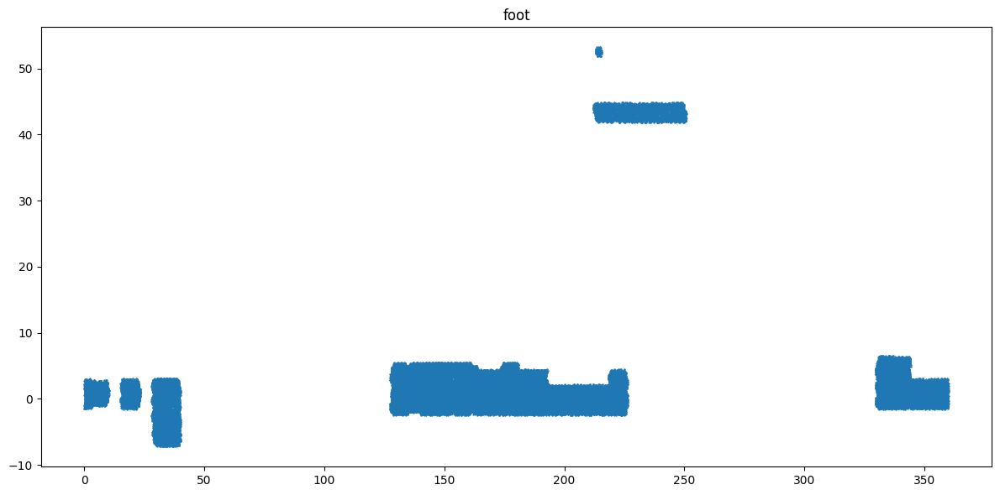

In [4]:
mkp.plot(stage='foot') # todo check wwrapped behaviour of the  mask at ra=0

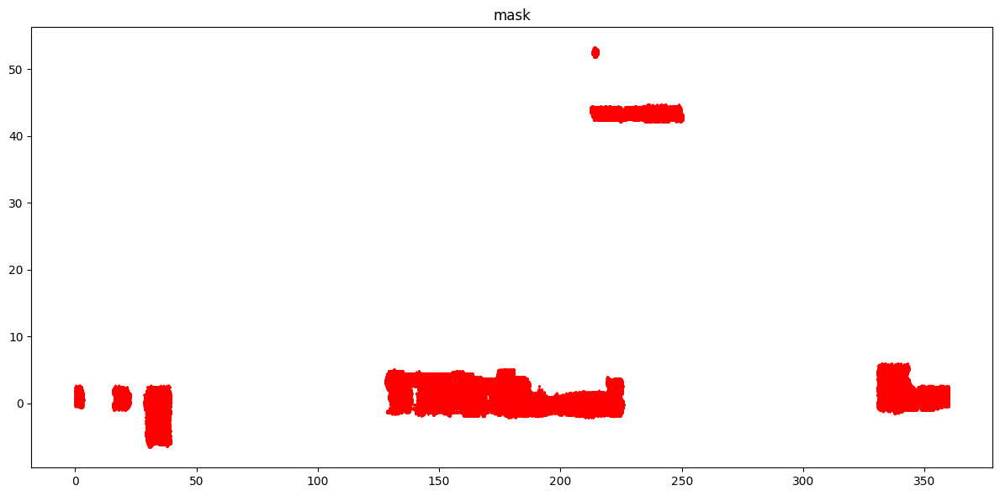

In [5]:
mkp.plot(stage='mask', nr=500_000, s=0.09, color='r')

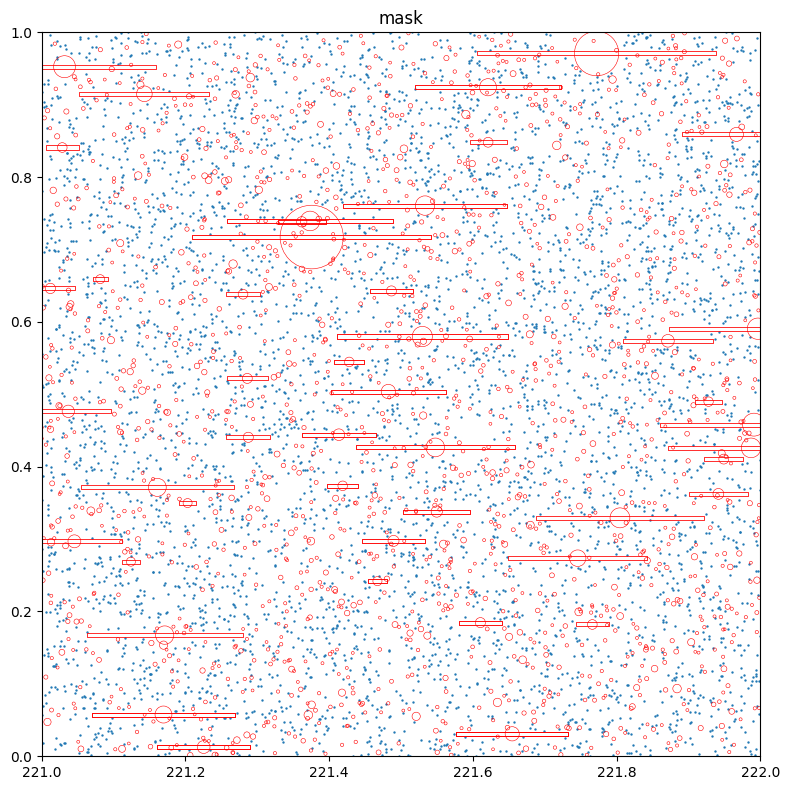

In [6]:
# Change figsize, zoom, overlay stars, overlay boxes
mkp.plot(stage='mask', nr=4_000_000, figsize=[8,8], xwin=[221,222], ywin=[0,1], plot_stars=True, plot_boxes=True)

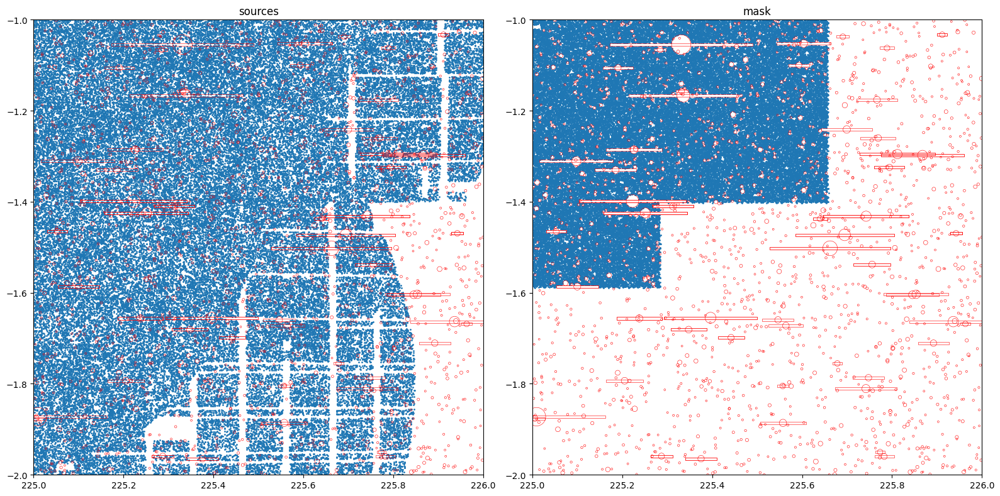

In [8]:
# Plot sources on the left, and randoms over the final mask on the right
mkp.plot2compare(stage='mask', nr=200_000_000, s=1, figsize=[16,8], xwin=[225,226], ywin=[-2,-1], 
                 plot_stars=True, plot_boxes=True)

In [9]:
rands = mkp.makerans(stage='mask', nr=500_000_000)
rands[0:10]

ra,dec
float64,float64
352.49584436416626,0.9679976908819674
37.0850533246994,-5.456256984102735
144.2902171611786,0.9976541821484454
190.4713976383209,0.845986095288977
37.153894901275635,-6.2065617570687515
151.50217831134796,3.9153881414057494
37.104547619819634,-1.029774759268155
146.1075961589813,1.7684664965691324
182.60391533374786,1.817399162077488


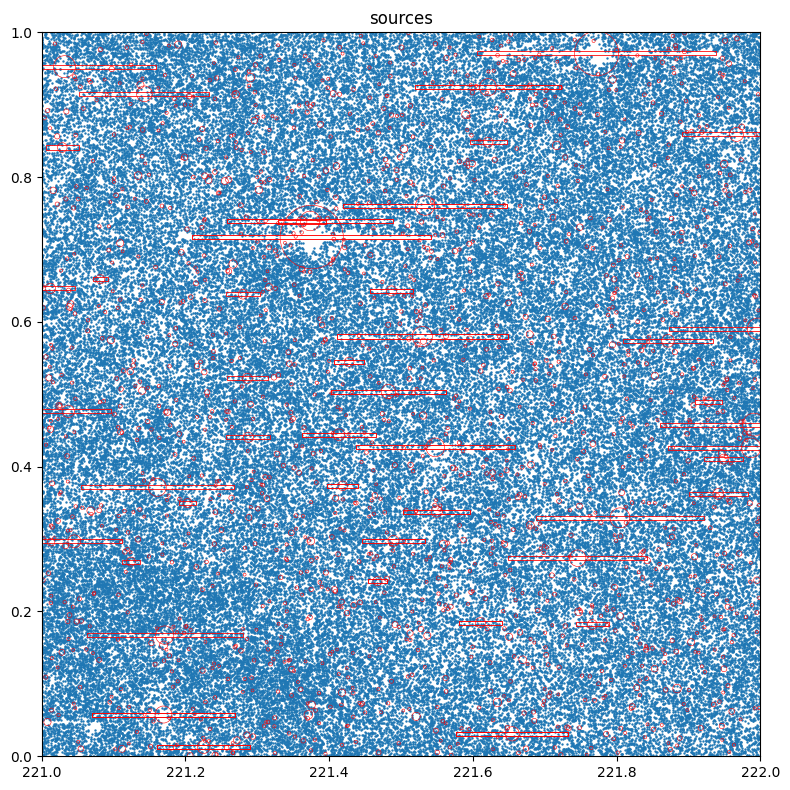

In [10]:
mkp.plot(stage='mask', nr=4_000_000, figsize=[8,8], xwin=[221,222], ywin=[0,1], plot_stars=True, plot_boxes=True, use_srcs=True)

In [11]:
# Fix and search form parameters from HSC data (i.e. rebuild hipcat catalog from big_df)

In [61]:
# Use apply() to return a catalog filtered by the mask
import lsdb
srcs = lsdb.read_hipscat(HIPCAT).compute() #, columns=['ra_mag','dec_mag']).compute()
srcs_masked = mkp.apply(stage='mask', cat=srcs, columns=['ra_mag','dec_mag'])

86735913 sources within mask


In [62]:
srcs.columns

Index(['object_id_mag', 'g_cmodel_mag_mag', 'r_cmodel_mag_mag',
       'isprimary_mag', 'i_cmodel_mag_mag', 'z_cmodel_mag_mag',
       'y_cmodel_mag_mag', 'g_cmodel_magerr_mag', 'r_cmodel_magerr_mag',
       'i_cmodel_magerr_mag', 'z_cmodel_magerr_mag', 'y_cmodel_magerr_mag',
       'i_extendedness_value_mag', 'ra_mag', 'dec_mag', 'Norder_mag',
       'Dir_mag', 'Npix_mag', 'object_id_pz', 'photoz_best_pz',
       'photoz_conf_best_pz', 'photoz_risk_best_pz', 'stellar_mass_pz',
       'sfr_pz', 'ra_pz', 'dec_pz', 'Norder_pz', 'Dir_pz', 'Npix_pz',
       '_dist_arcsec', 'coord_ra_hsc_g', 'coord_dec_hsc_g',
       'modelfit_CModel_fracDev_hsc_g', 'modelfit_CModel_exp_apCorr_hsc_g'],
      dtype='object')

In [12]:
mkp.foot

HealSparseMap: nside_coverage = 16, nside_sparse = 32768, bool, 335224064 valid pixels

In [13]:
mkp.mask

HealSparseMap: nside_coverage = 16, nside_sparse = 32768, bool, 210985195 valid pixels

In [48]:
import healpy as hp
NSIDE = 2**15
print(
    "Approximate resolution at NSIDE {} is {:.2} arcsec".format(
        NSIDE, hp.nside2resol(NSIDE, arcmin=True)*60
    )
)

Approximate resolution at NSIDE 32768 is 6.4 arcsec


In [16]:
from astropy.io import fits
fits_image_filename = '../../50MGC/data/catalog.fits'
hdul = fits.open(fits_image_filename)srcs_masked

In [17]:
hdul.info()

Filename: ../../50MGC/data/catalog.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1                1 BinTableHDU    256   15424R x 58C   [29A, J, J, J, D, D, D, D, D, D, D, D, D, 3A, D, D, D, D, D, 6A, 6A, D, E, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, D, 32A, D, D, 32A, J, J, D, D, D, D, D, D, 64A, D, D, D, D, D]   


In [18]:
data = hdul[1].data

In [19]:
import pandas as pd
nearby_galax_df = pd.DataFrame(data)

In [20]:
nearby_galax_df

,objname,pgc,nsaid,group_id,ra,dec,ra_nsa,dec_nsa,ra_ned,dec_ned,...,logmass_BV,logmass_BR,logmass,logmass_error,logmass_src,chandra_observation,chandra_detection,log_lx,chandra_detection_3arcsec,log_lx_3arcsec
0,2MASXJ01235631+0012308,3519080,114636,-1,20.984826,0.208487,20.984777,0.208338,20.98476,0.20850,...,NaN,NaN,8.166,0.150,g-i,0.0,0.0,NaN,0.0,NaN
1,2MASXJ04575930-0612323,3689848,-1,-1,74.497114,-6.208914,NaN,NaN,74.49712,-6.20889,...,NaN,NaN,NaN,NaN,,0.0,0.0,NaN,0.0,NaN
2,2MASXJ05534289-3205449,3704923,-1,-1,88.428899,-32.095887,NaN,NaN,88.42883,-32.09581,...,NaN,NaN,NaN,NaN,,0.0,0.0,NaN,0.0,NaN
3,2MASXJ06094464-3250007,3707868,-1,-1,92.436063,-32.833630,NaN,NaN,92.43604,-32.83361,...,NaN,NaN,NaN,NaN,,0.0,0.0,NaN,0.0,NaN
4,2MASXJ07415401+2352188,3723606,-1,-1,115.475523,23.871764,NaN,NaN,115.47567,23.87175,...,NaN,NaN,8.707,0.191,g-r,0.0,0.0,NaN,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15419,SDSSJ023330.49+270105.9,-1,693441,-1,38.385819,27.020799,38.385819,27.020799,NaN,NaN,...,NaN,NaN,7.781,0.185,g-i,0.0,0.0,NaN,0.0,NaN
15420,SDSSJ024055.00+263957.9,-1,693442,-1,40.231793,26.666904,40.231793,26.666904,NaN,NaN,...,NaN,NaN,7.737,0.210,g-i,0.0,0.0,NaN,0.0,NaN
15421,SDSSJ121814.50+134445.9,-1,693678,-1,184.564001,13.748644,184.564001,13.748644,NaN,NaN,...,NaN,NaN,8.055,0.136,g-i,0.0,0.0,NaN,0.0,NaN
15422,SDSSJ133850.79+080637.9,-1,694295,-1,204.710705,8.108386,204.710705,8.108386,NaN,NaN,...,NaN,NaN,7.251,0.585,g-i,0.0,0.0,NaN,0.0,NaN


In [21]:
len(nearby_galax_df)

15424

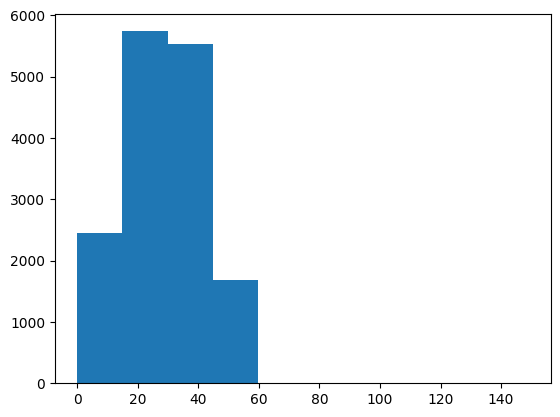

In [22]:
import matplotlib.pyplot as plt
plt.hist(nearby_galax_df["bestdist"])
plt.show()

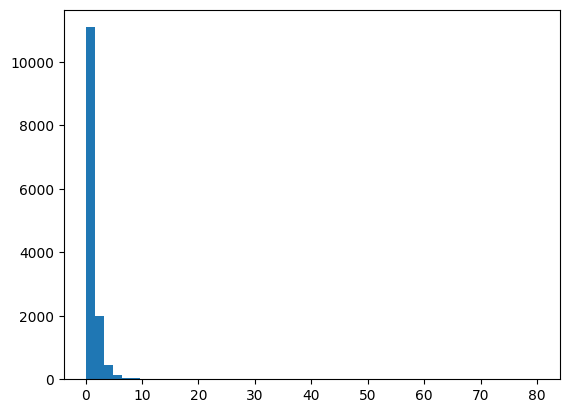

In [42]:
import matplotlib.pyplot as plt
plt.hist(nearby_galax_df["d25"], range=[0.1, 80], bins=50)
plt.show()

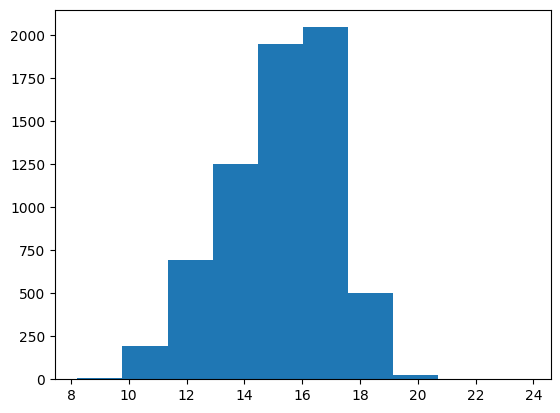

In [24]:
import numpy as np
plt.hist(-2.5*np.log10(nearby_galax_df["i_lum_nsa"])+5*np.log10(nearby_galax_df["bestdist"]*1e6))
plt.show()

In [25]:
import healpy as hp
from healpy.newvisufunc import projview, newprojplot
from healpy.visufunc import projscatter
from healpy.pixelfunc import ang2pix

In [27]:
new_df = pd.concat([nearby_galax_df["objname"], nearby_galax_df["ra"], nearby_galax_df["dec"], nearby_galax_df["bestdist"], nearby_galax_df["d25"], nearby_galax_df["i_lum_nsa"]], axis=1, keys=['objname','ra', 'dec', "bestdist", "d25", "i_lum_nsa"], )

In [32]:
# Use apply() to return a catalog filtered by the mask
srcs_masked = mkp.apply(stage='mask', cat=new_df, columns=['ra','dec'])

551 sources within mask


In [34]:
srcs_masked.reset_index(inplace=True, drop=True)

In [35]:
srcs_masked

,objname,ra,dec,bestdist,d25,i_lum_nsa
0,2MASXJ01235631+0012308,20.984826,0.208487,32.217,0.451856,2.537634e+08
1,2MASXJ10315596+0400122,157.983264,4.003336,43.505,0.262422,3.941956e+08
2,AGC229174,183.259108,1.260630,33.361,NaN,NaN
3,AGC229177,185.417308,1.840331,31.022,NaN,NaN
4,BootesIV,233.689167,43.726111,0.210,12.658654,NaN
...,...,...,...,...,...,...
546,SDSSJ021024.39-044153.9,32.601506,-4.698499,34.011,NaN,1.628357e+08
547,SDSSJ112107.00+032807.0,170.279458,3.468441,25.177,NaN,8.806956e+07
548,SDSSJ115915.29+030157.9,179.813610,3.032764,28.795,NaN,1.375655e+07
549,SDSSJ122821.60+015645.9,187.089890,1.946057,48.707,NaN,7.149007e+07


1 2MASXJ01235631+0012308 20.984826 0.2084866 0.4518559443749224 16.52935312144288 32.217


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


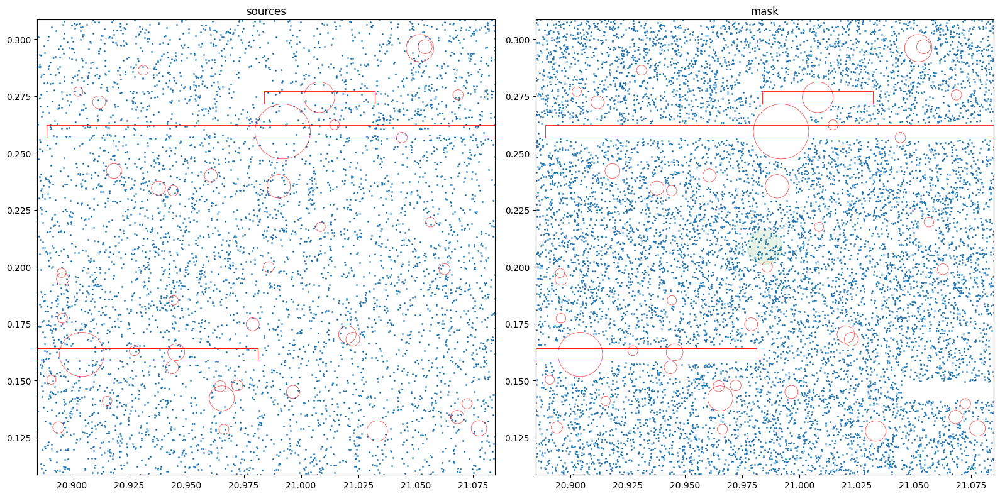

2 2MASXJ10315596+0400122 157.983264 4.0033362 0.26242185433844417 16.70341630338698 37.874


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


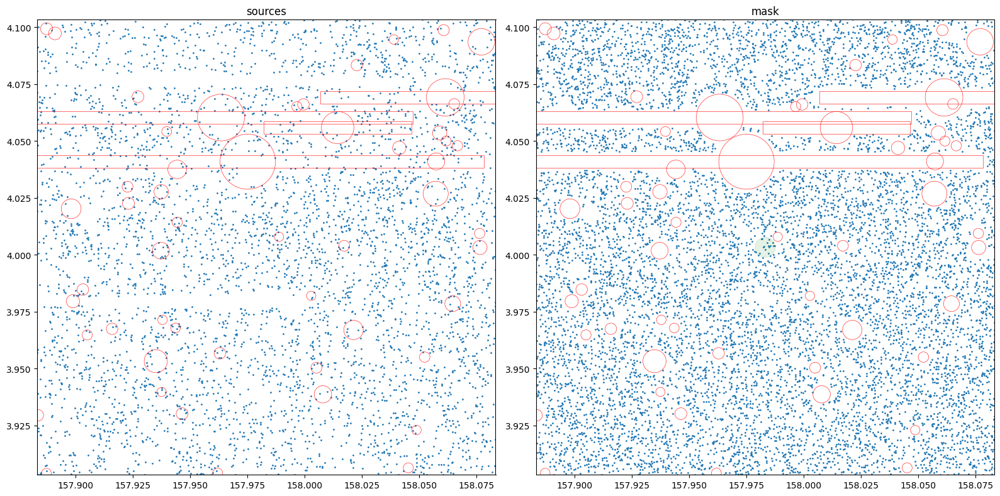

3 CFRS14.0573 214.5087705 52.518115 0.23768402866248767 17.313185094283032 15.721


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


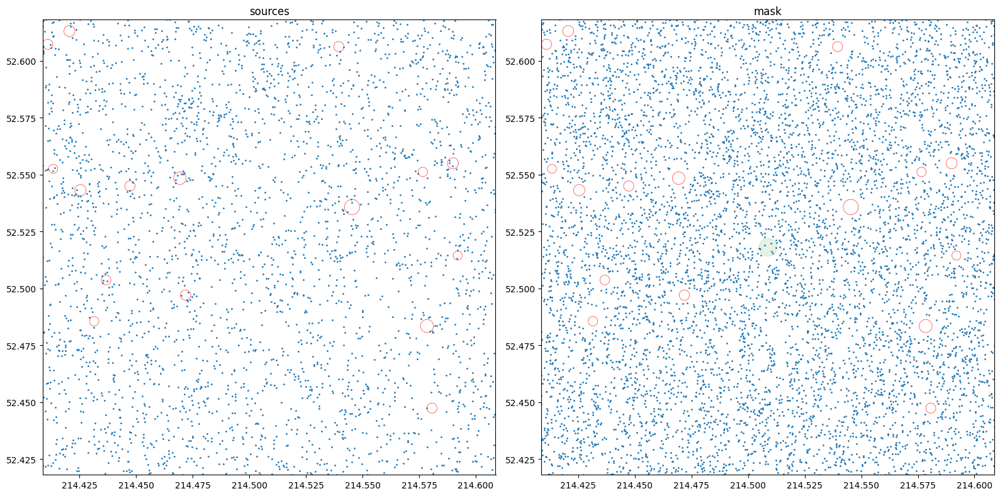

4 IC0088 18.5850105 0.9168752 0.5675446054085471 16.581909759923654 49.21


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


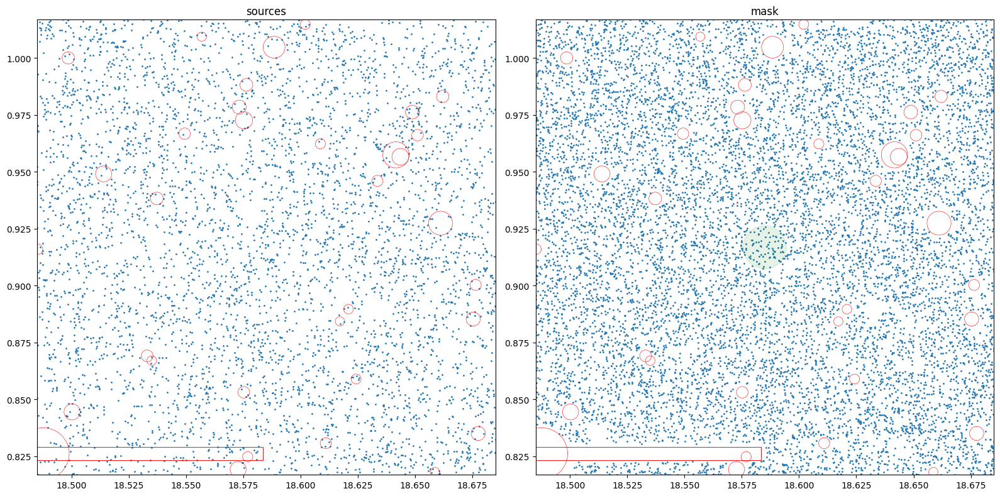

5 IC0225 36.617832 1.1605165 1.0092528860766845 13.91779797280752 26.826


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


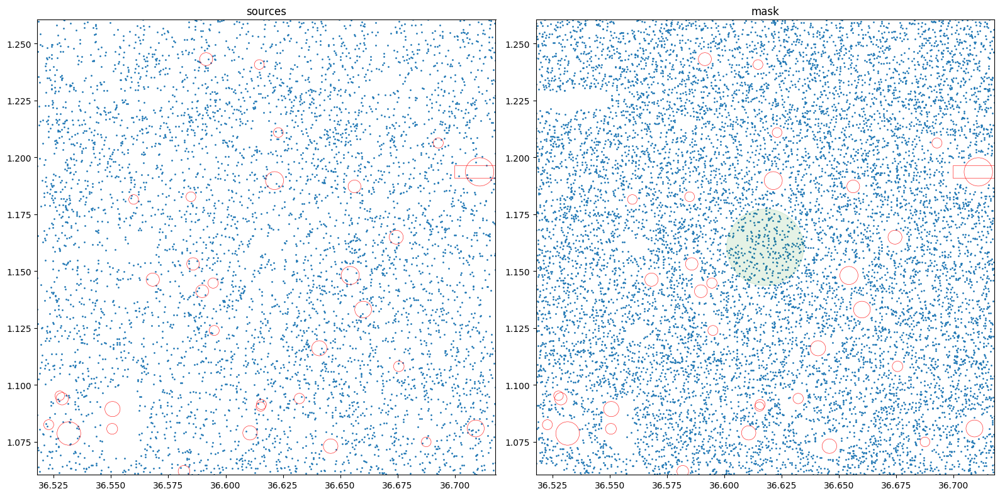

6 IC0549 145.180089 3.9592469 0.5997910762555094 14.950210527202874 50.415


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


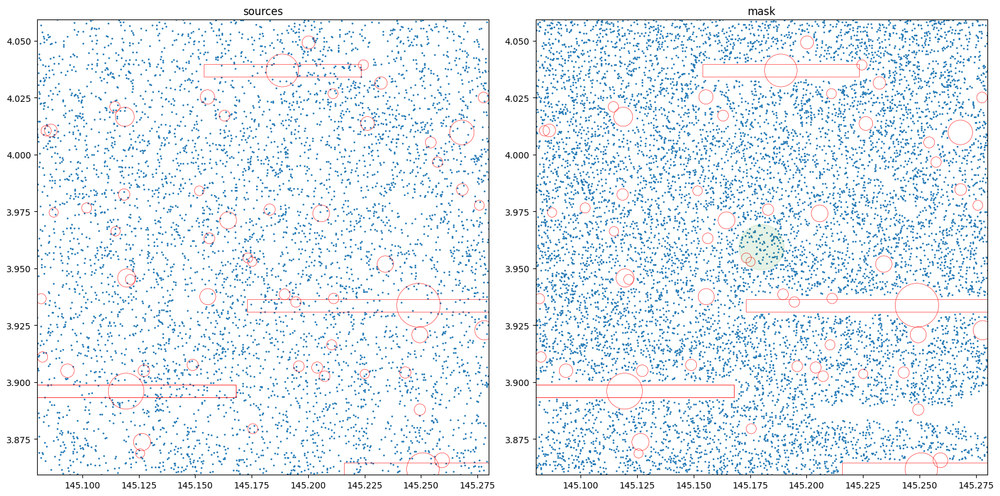

7 NGC0493 20.5374015 0.9455526 3.0060763026282307 12.586573967986581 43.989


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


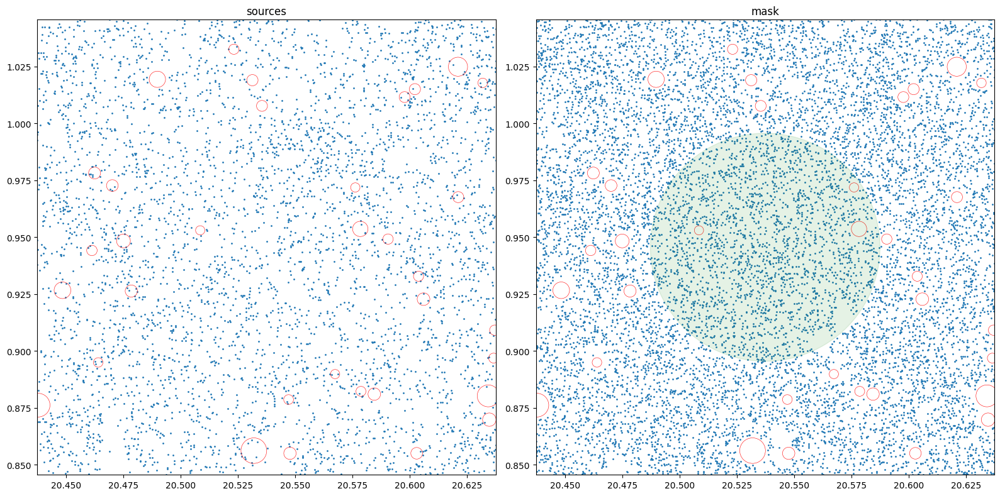

8 NGC0941 37.116132 -1.1514899 1.8706821403658007 12.537361157663653 43.505


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


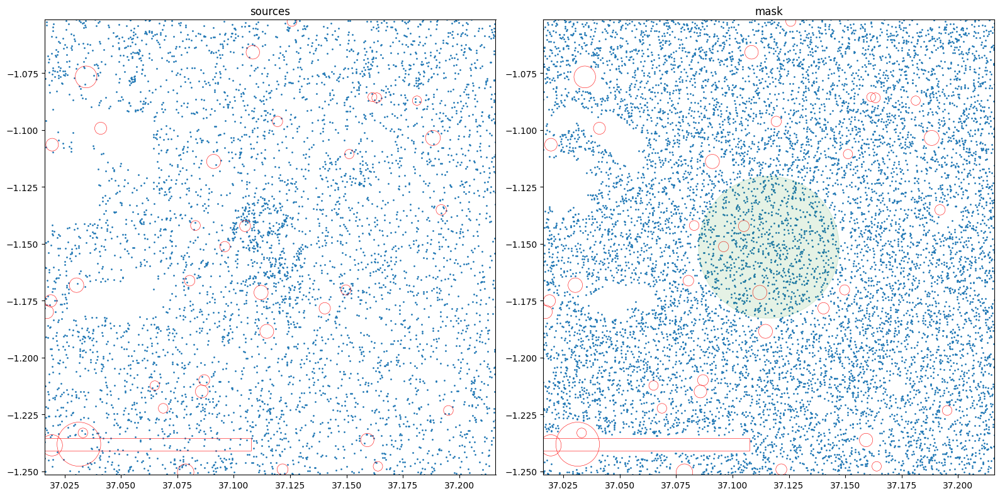

9 NGC3023 147.469026 0.6181686 1.8197008586099834 12.861463075887926 37.753


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


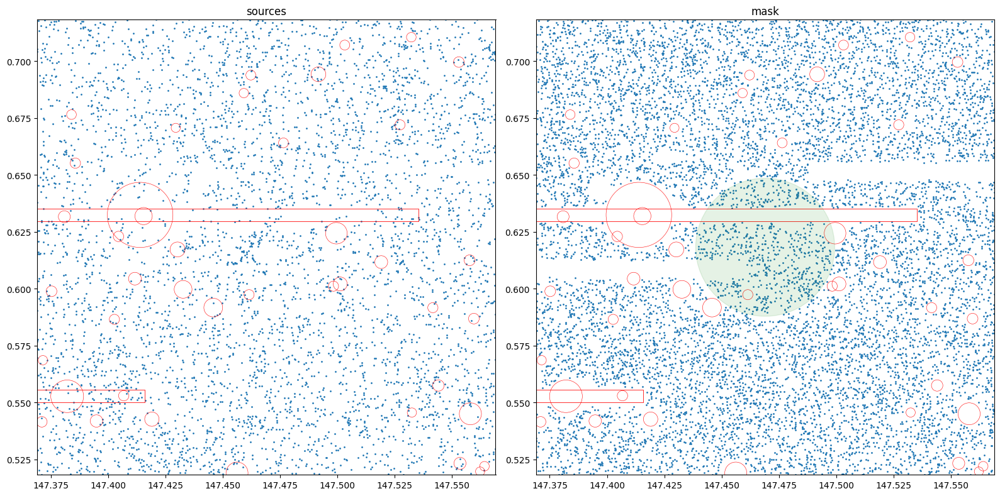

10 NGC3044 148.420374 1.5795904 4.1975898399100755 11.920575875020695 42.042


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


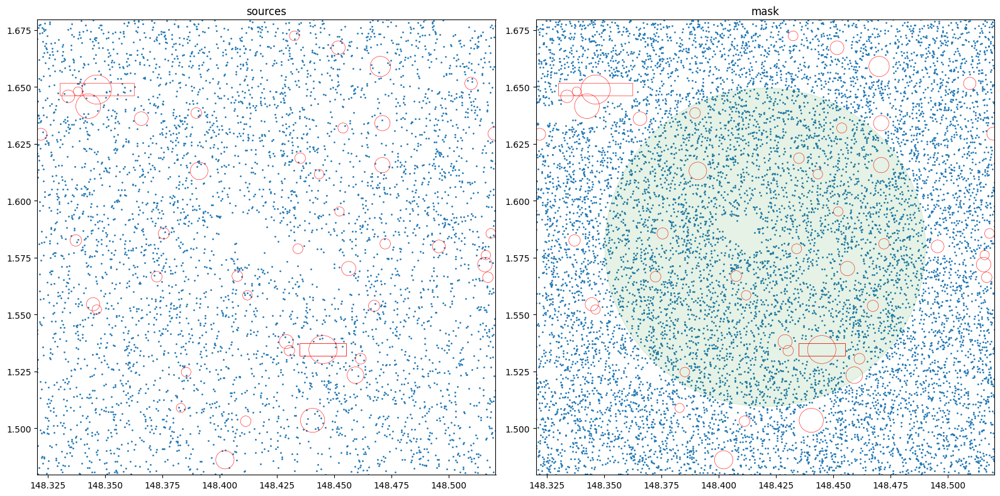

11 NGC3055 148.8252015 4.2699953 1.9633602768360463 12.111238188860494 43.238


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


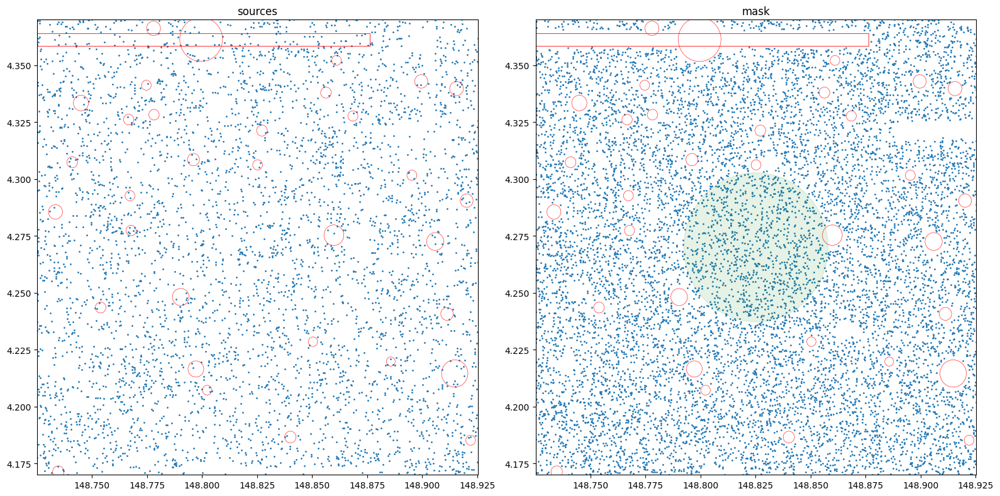

12 NGC3165 153.3804105 3.3749946 1.1721953655481303 14.00440457882167 30.949


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


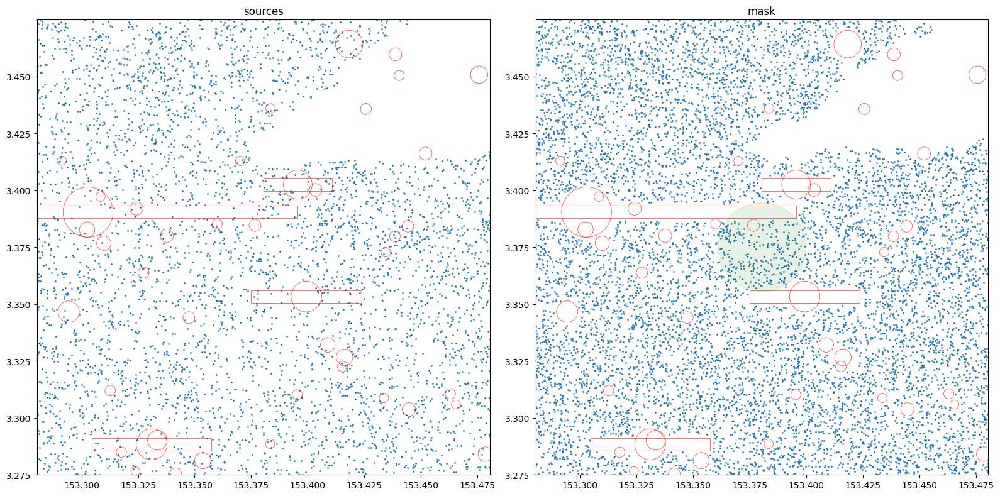

13 NGC3246 156.674193 3.8619617 1.9408858775927782 12.973107413475041 46.538


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


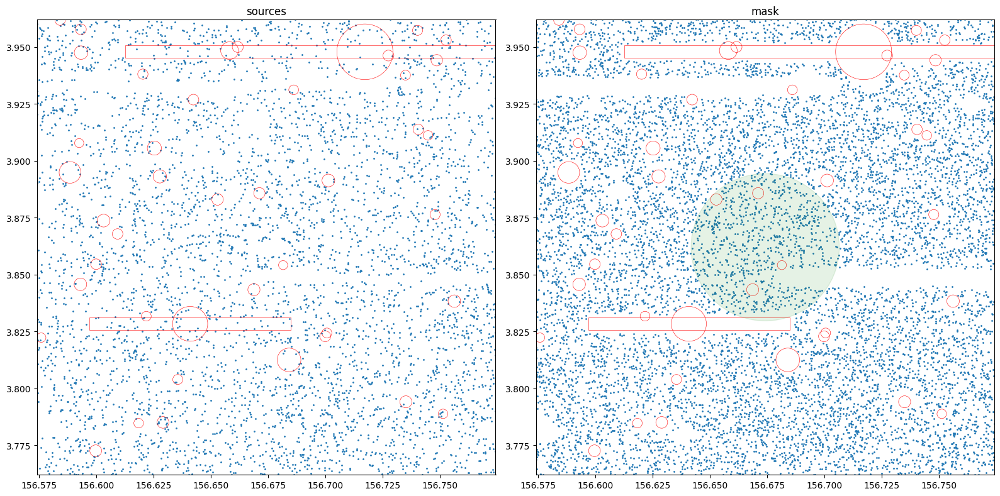

14 NGC3633 170.109414 3.5856988 1.1885022274370183 13.089297634660419 25.995


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


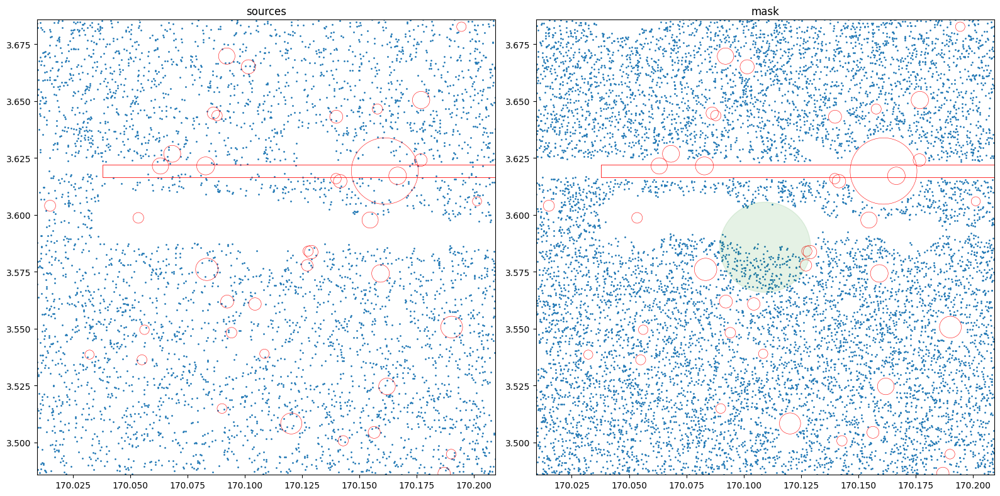

15 NGC4030 180.0983565 -1.100072 3.81065823393773 10.469097339889025 31.398


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


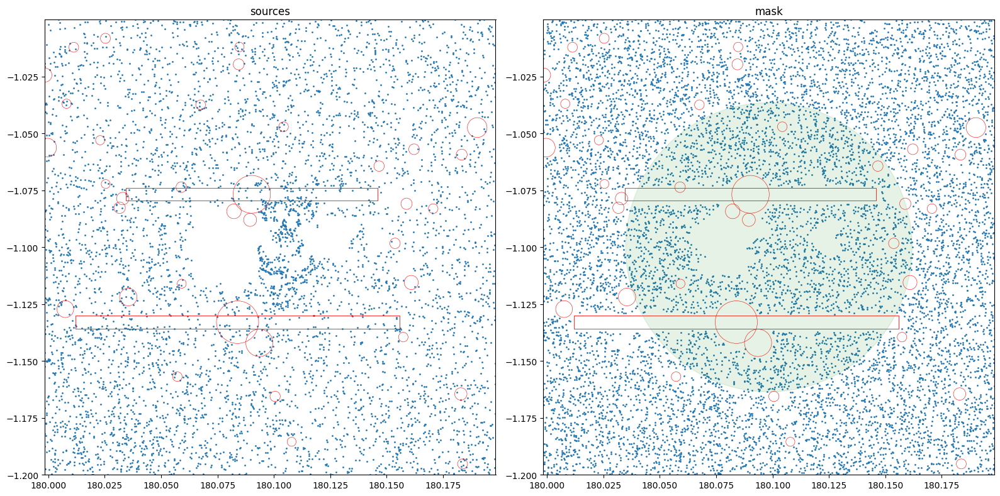

16 NGC4116 181.903626 2.6920426 2.5703957827688635 12.313295262946408 36.083


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


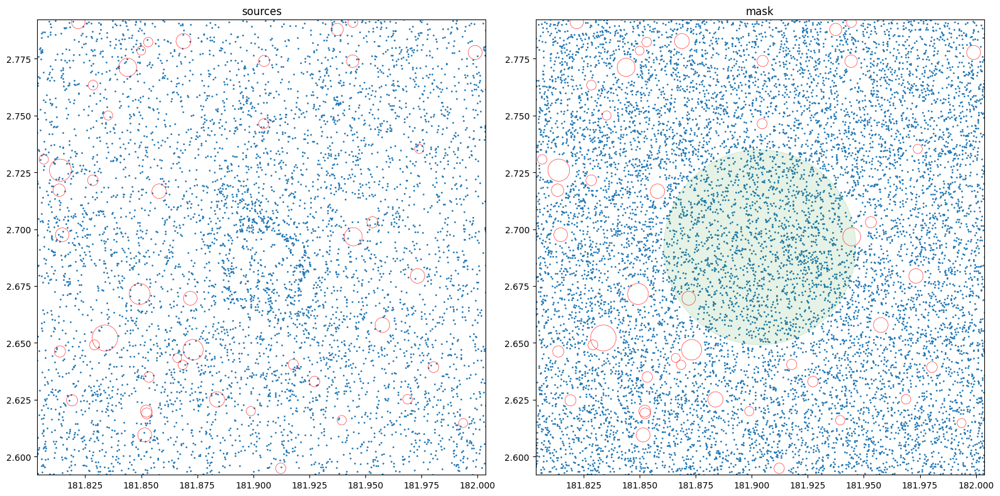

17 NGC4123 182.046336 2.8783017 3.1768740706497707 11.26960230329469 37.248


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


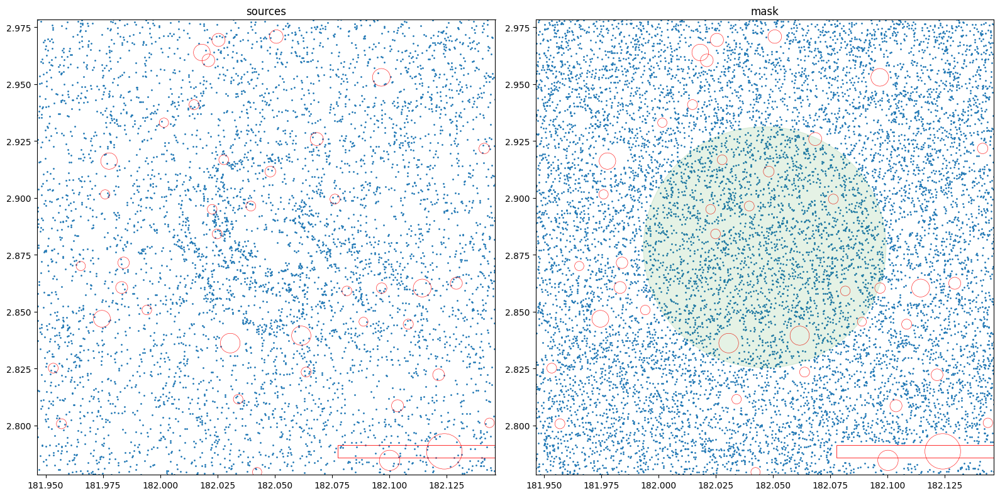

18 NGC4179 183.2170995 1.2997088 4.477133041763626 11.158167224322405 50.735


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


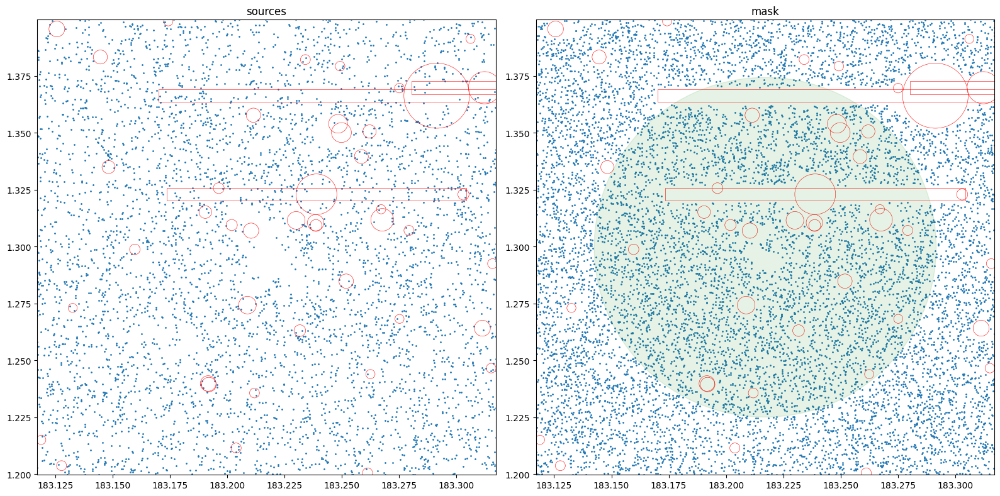

19 NGC4234 184.287972 3.682903 1.1534532578210923 12.805385460233126 24.556


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


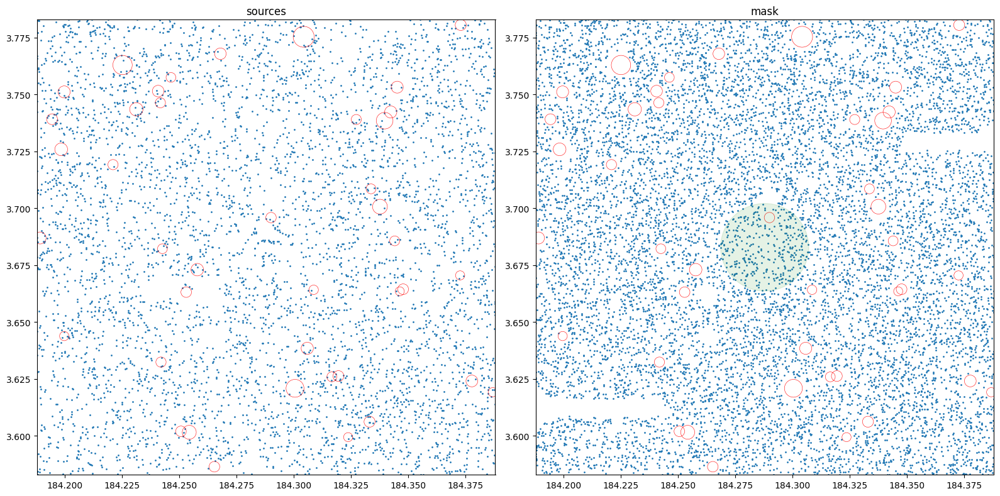

20 NGC4289 185.259471 3.722077 4.2559841313374305 13.19148468479812 52.149


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


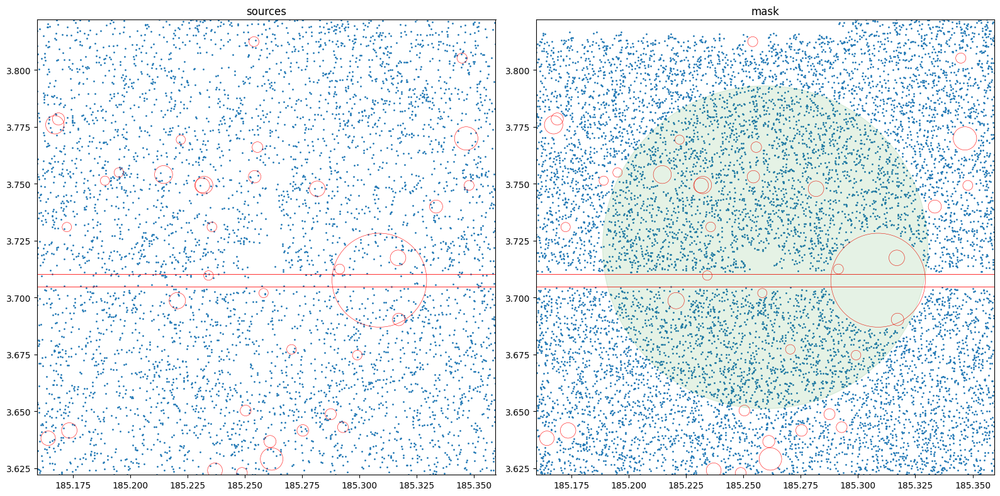

21 NGC4409 186.743694 2.494399 1.8197008586099834 12.240997389827093 45.379


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


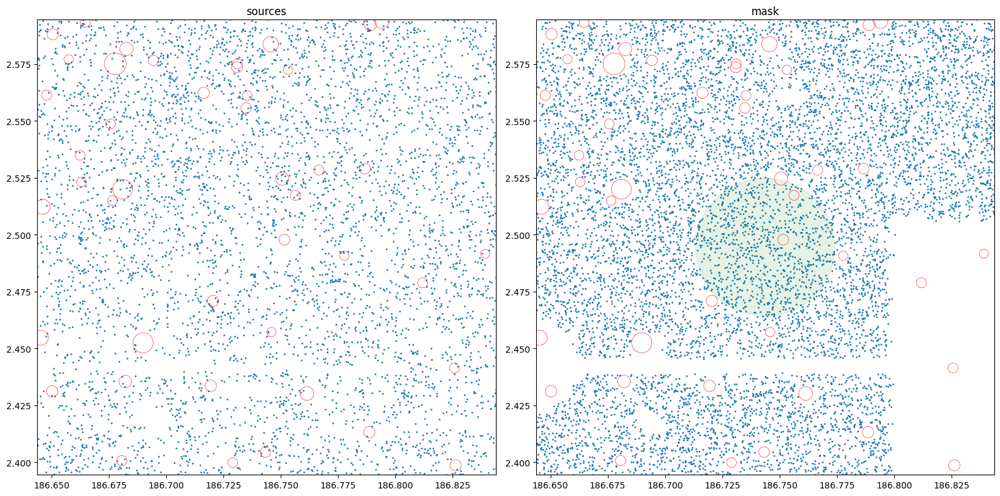

22 NGC4517A 188.1165195 0.3904251 2.046444636724674 12.475796676888805 46.507


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


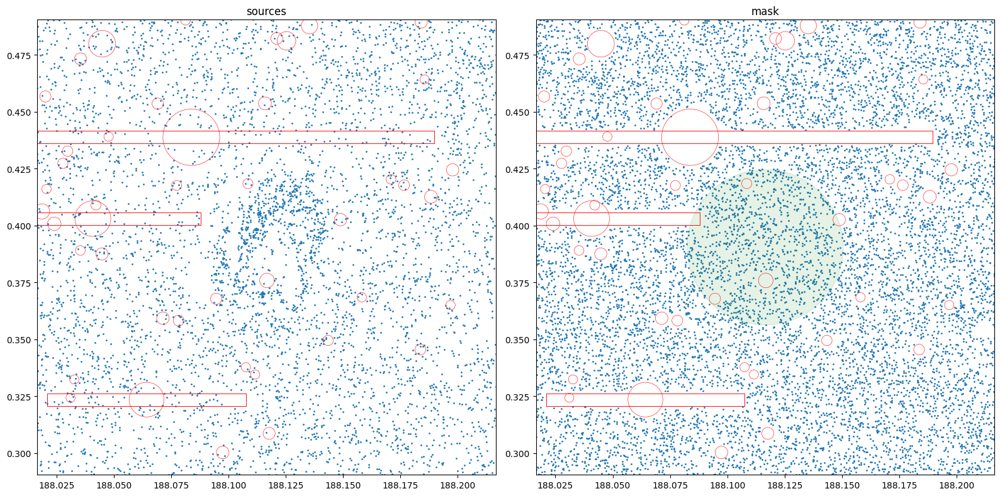

23 NGC4581 189.5215365 1.4777364 1.6218100973589298 12.347846294129628 31.327


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


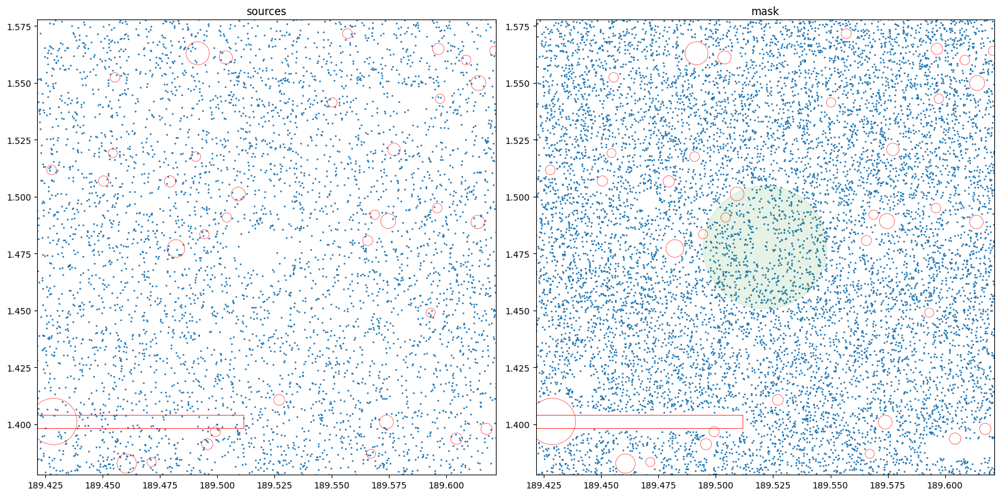

24 NGC4592 189.828048 -0.5318914 4.168693834703355 11.796834809211795 26.265


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


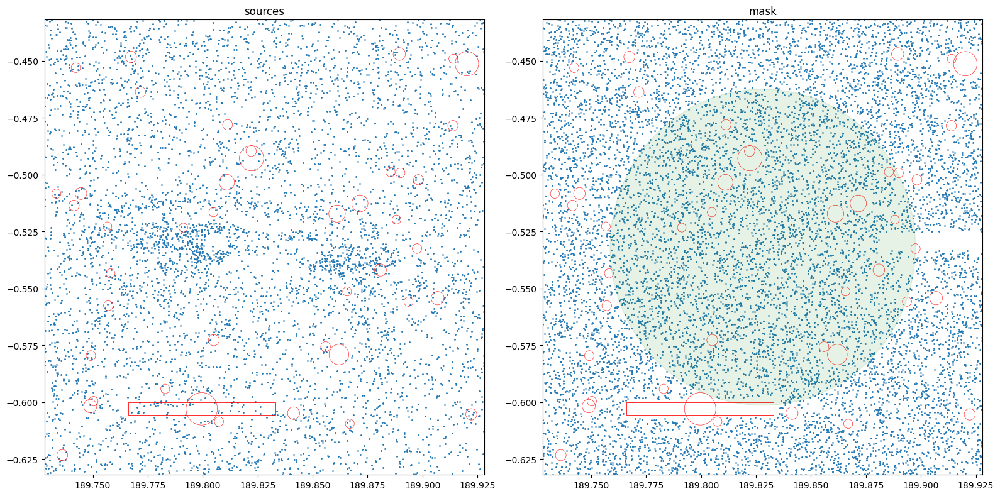

25 NGC4632 190.6347045 -0.0817873 2.5585858869056453 12.020992609352156 31.759


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


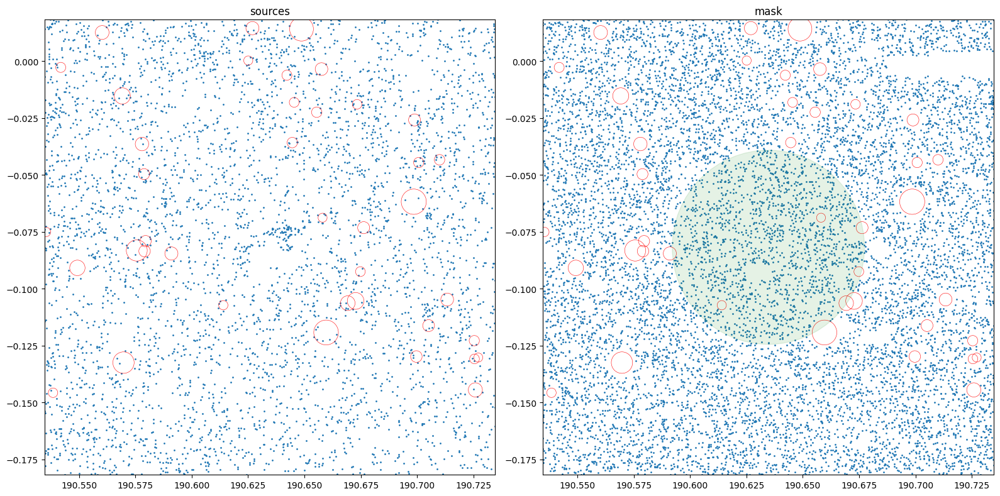

26 NGC4653 190.9622145 -0.5612163 2.328091257665008 12.352549738299842 42.253


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


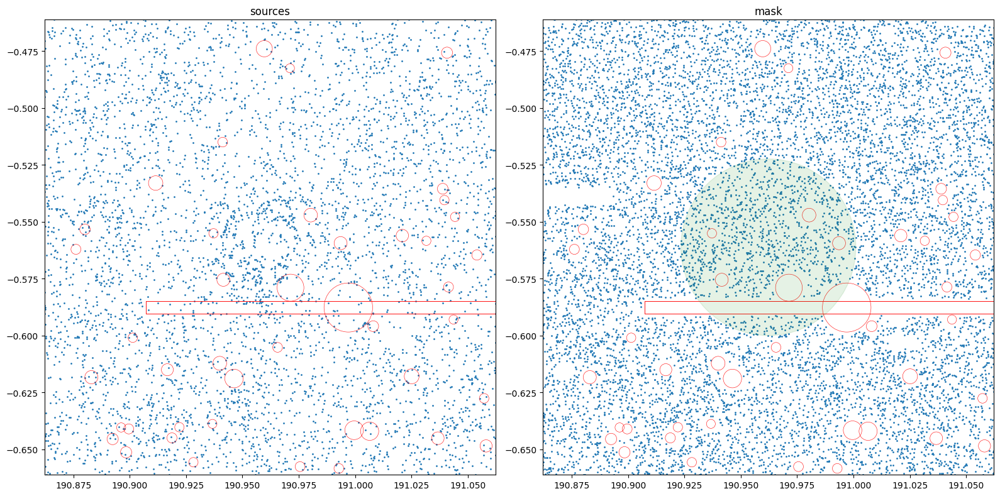

27 NGC4666 191.2859775 -0.4618785 4.96592321450336 10.470159805015584 16.5


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


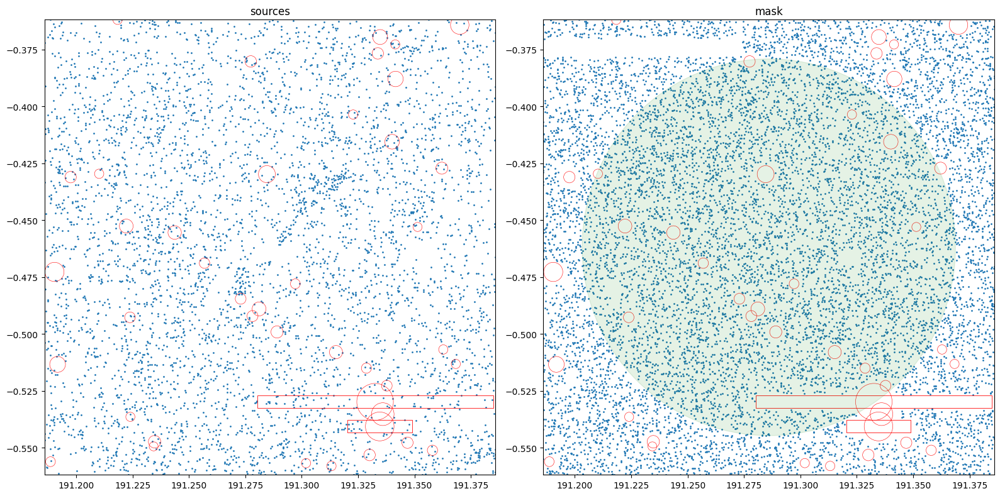

28 NGC4668 191.383203 -0.5355056 1.5885467485977791 13.019154460337639 9.55


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


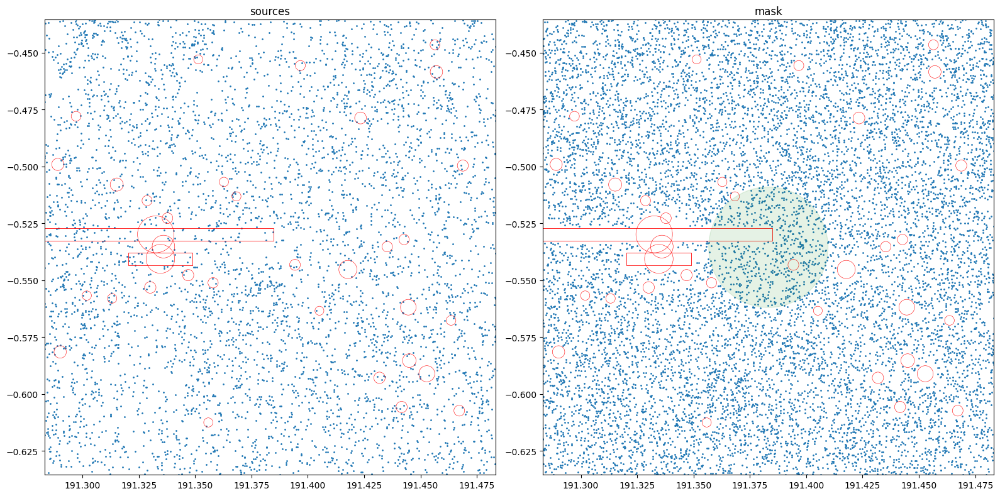

29 NGC4690 191.981334 -1.6559975 1.5958791472367329 12.507882605739528 39.445


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


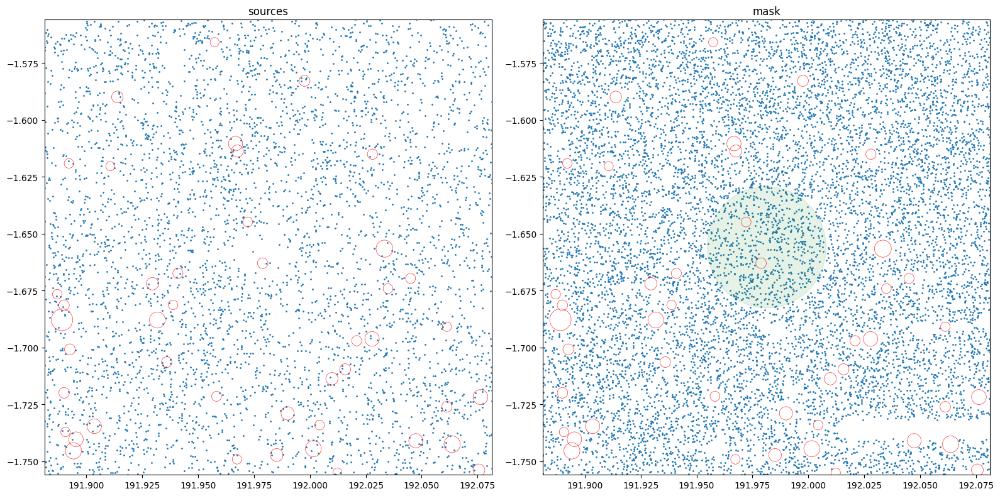

30 NGC4904 195.2443425 -0.0275732 1.9906733389871865 11.932110640552303 37.439


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


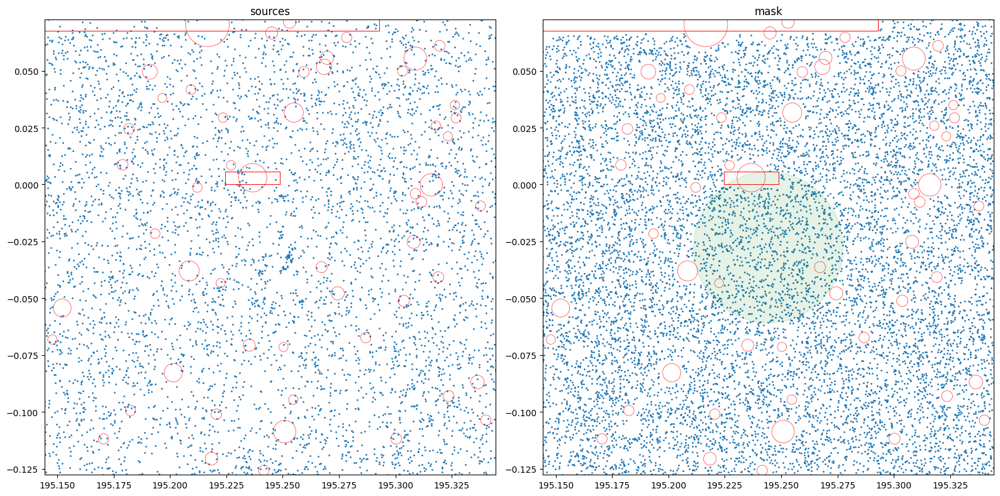

31 NGC5334 208.226907 -1.1146173 3.404081897010009 11.618508995430542 40.918


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


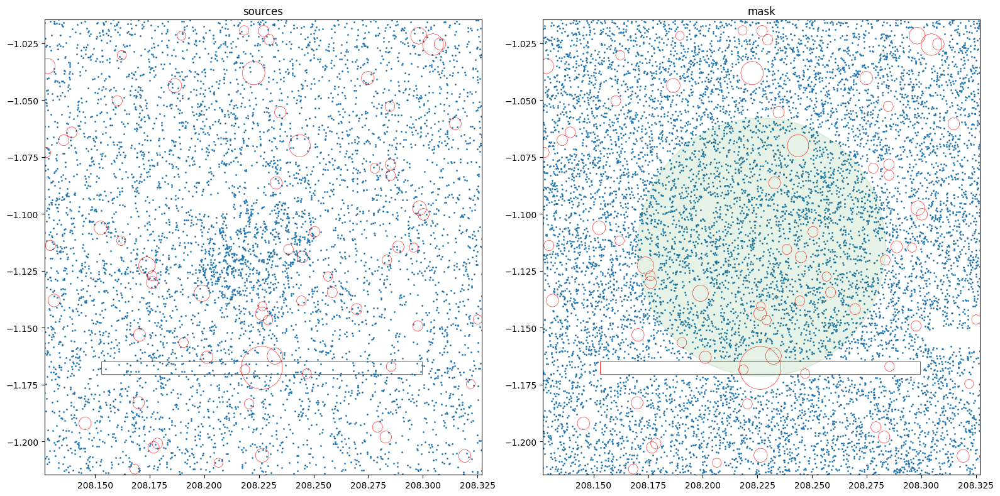

32 NGC5496 212.9076735 -1.1578822 2.691534803926915 12.97554434886532 28.5


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


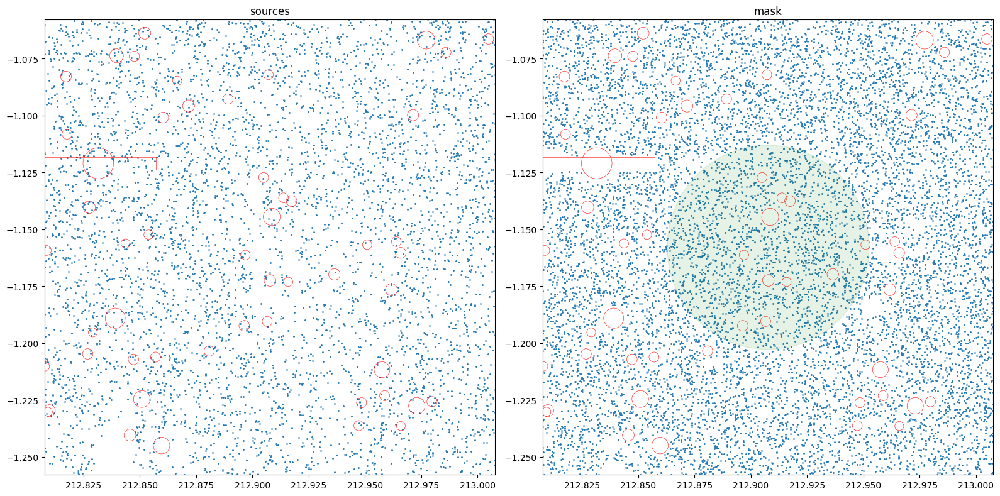

33 NGC5691 219.472221 -0.3988812 1.8578044550916981 12.221595984456169 33.875


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


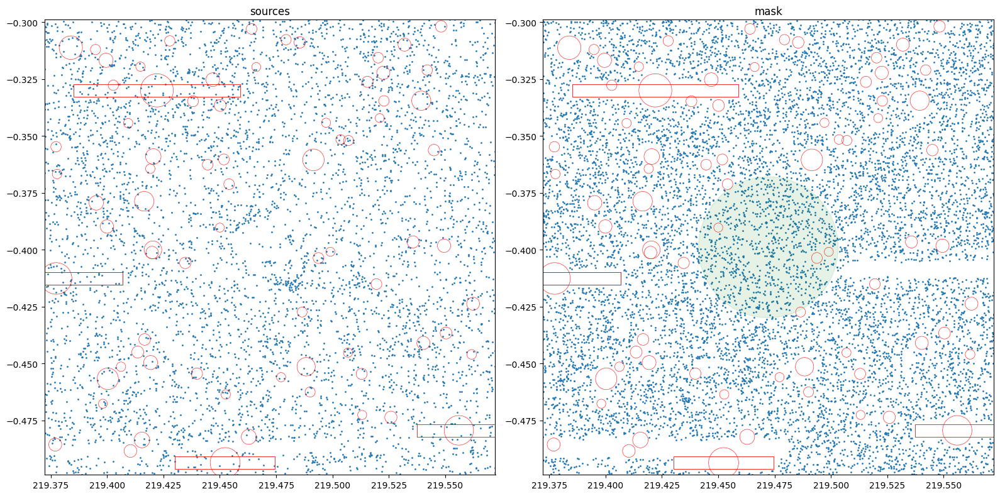

34 NGC5692 219.575478 3.4103085 0.9549925860214359 13.105908324935893 50.002


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


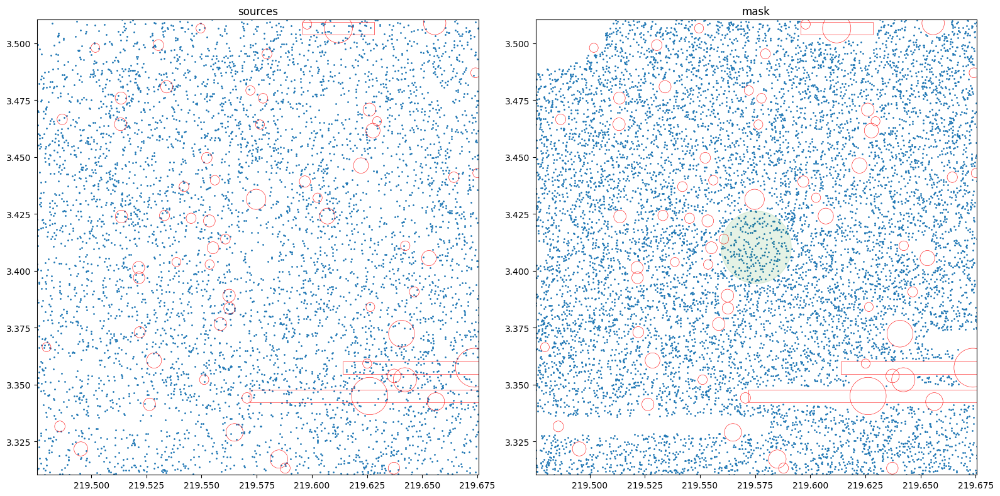

35 NGC5705 219.9574005 -0.7184204 1.3489628825916533 12.690102843957071 35.351


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


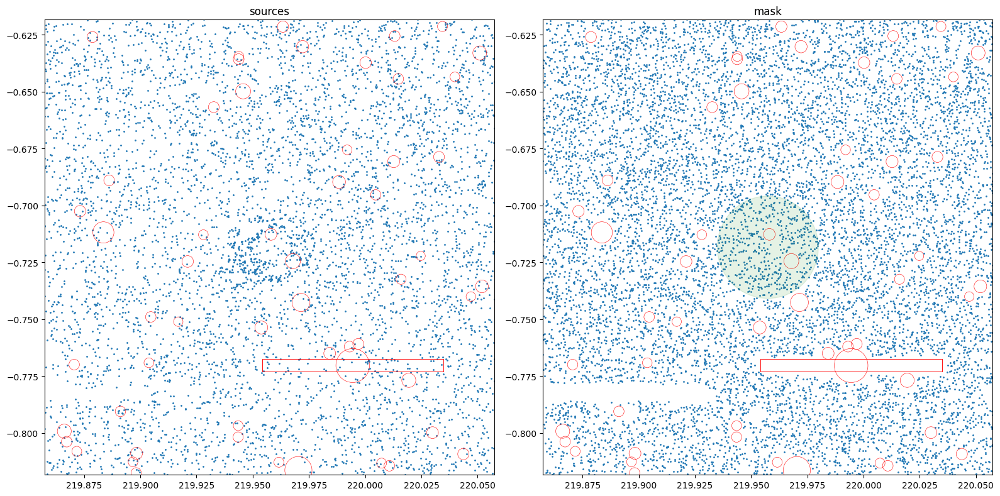

36 NGC5713 220.0479525 -0.2890039 2.4717241450161302 11.070423951694874 31.467


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


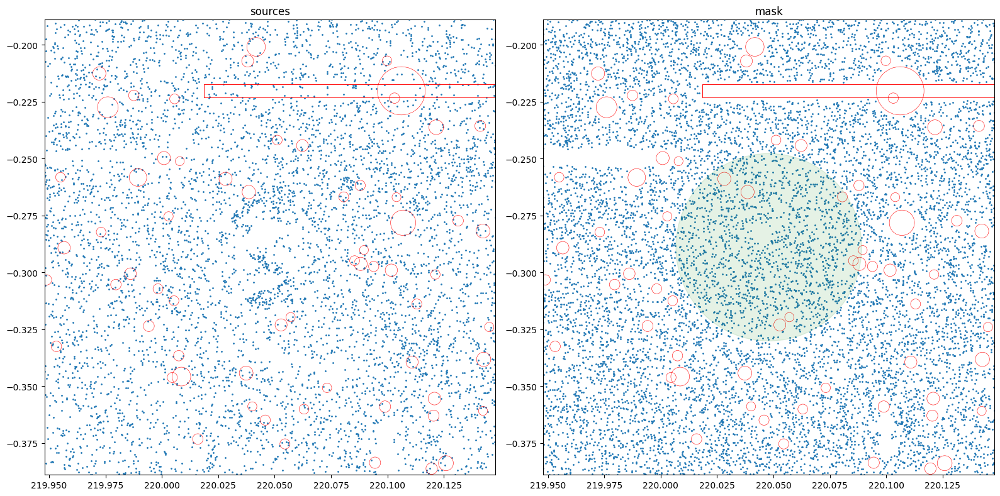

37 NGC5719 220.2348435 -0.3181669 3.083187950249355 11.342827634506747 49.675


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


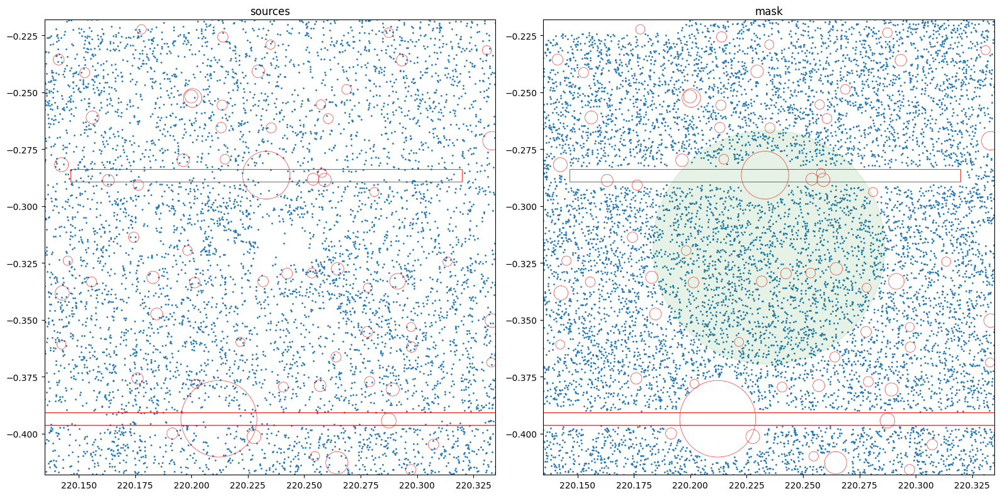

38 NGC5725 220.243176 2.186834 0.9549925860214359 13.867224422631615 25.805


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


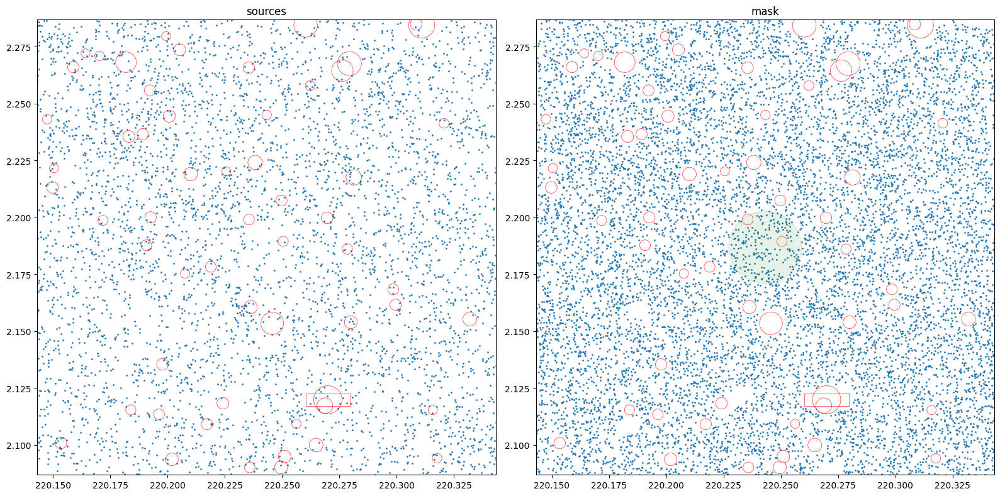

39 NGC5730 219.967392 42.7423322 2.0090928126087277 13.6292397426758 45.809


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


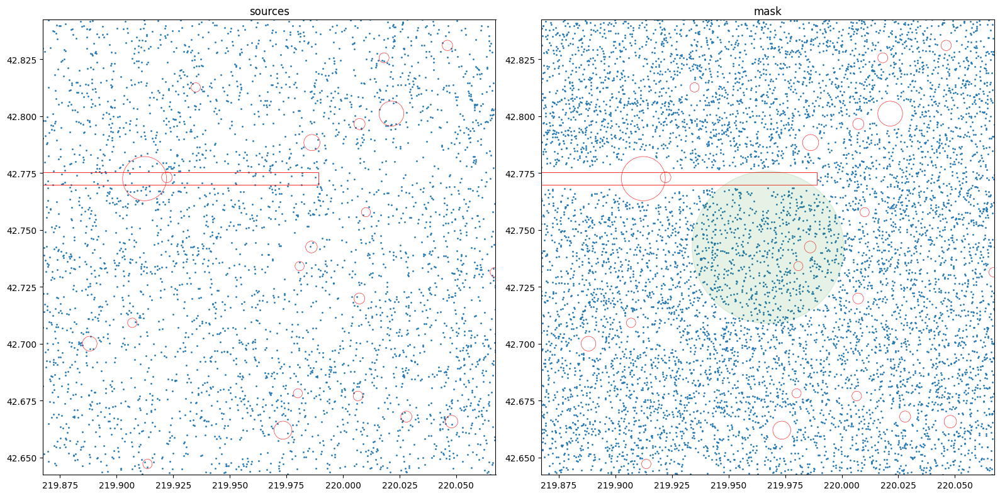

40 NGC5731 220.038375 42.7795421 1.5031419660900225 13.967856624355683 25.944


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


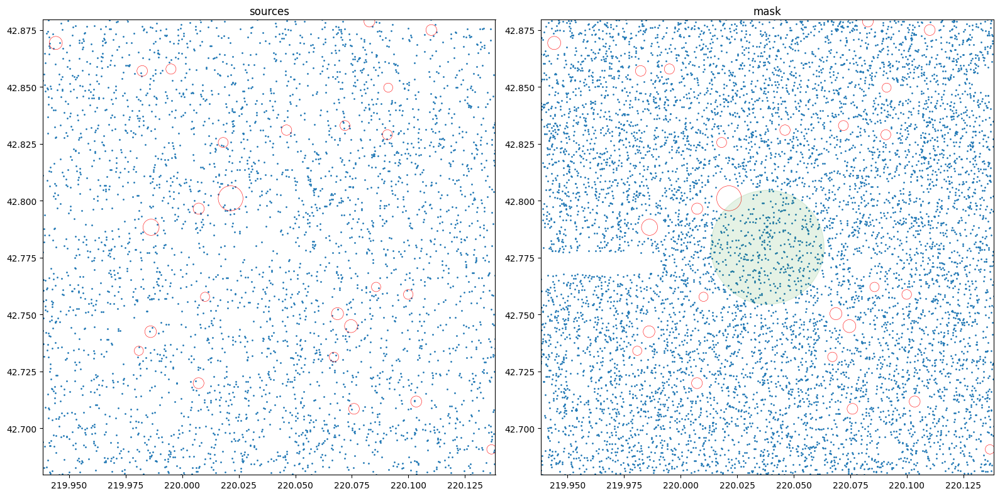

41 NGC5733 220.691286 -0.351183 0.9908319448927676 14.235580664965177 47.092


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


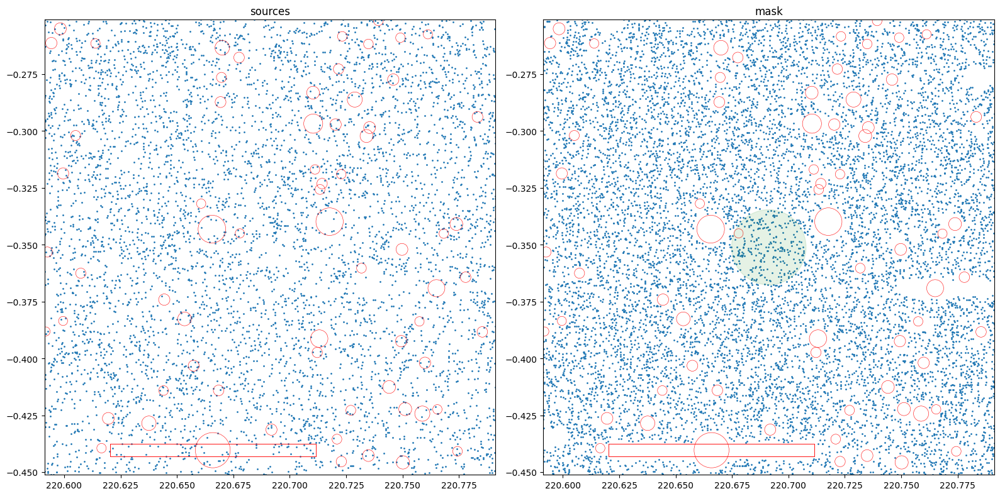

42 NGC5738 220.9849035 1.6041666 0.9397233105646378 13.770142623740917 40.129


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


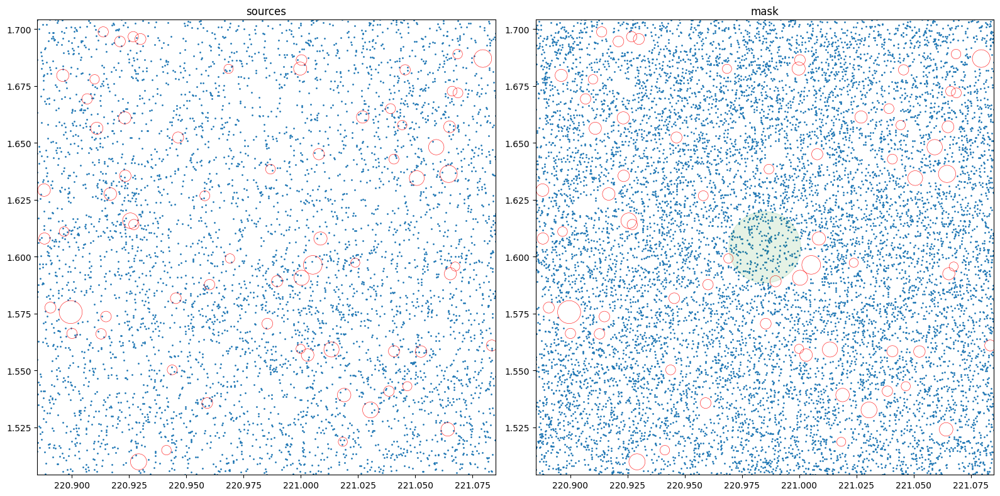

43 NGC5740 221.101833 1.6797606 2.6977394324449206 11.735372806376908 35.807


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


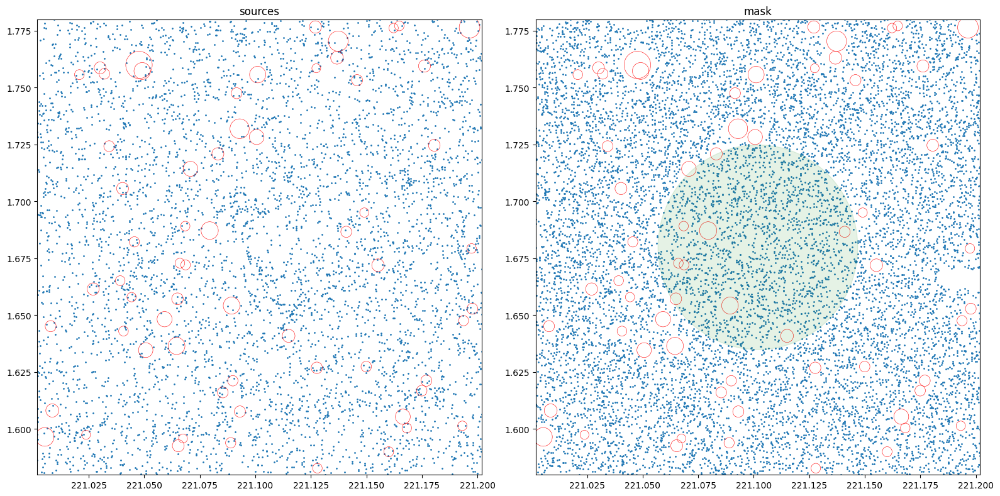

44 NGC5806 225.0016545 1.8912683 3.0269134281013064 11.164204426942177 37.037


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


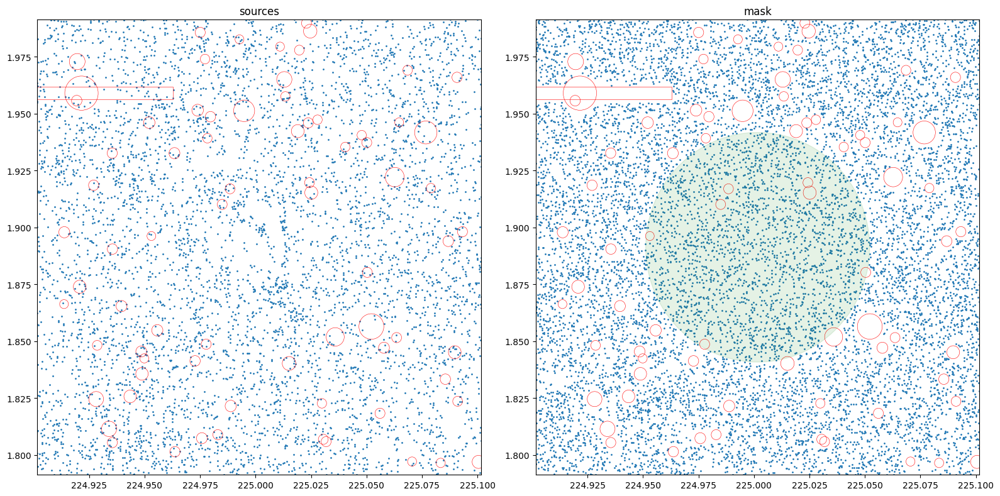

45 NGC5811 225.112773 1.6235808 1.0303861204416158 13.582599324590078 33.482


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


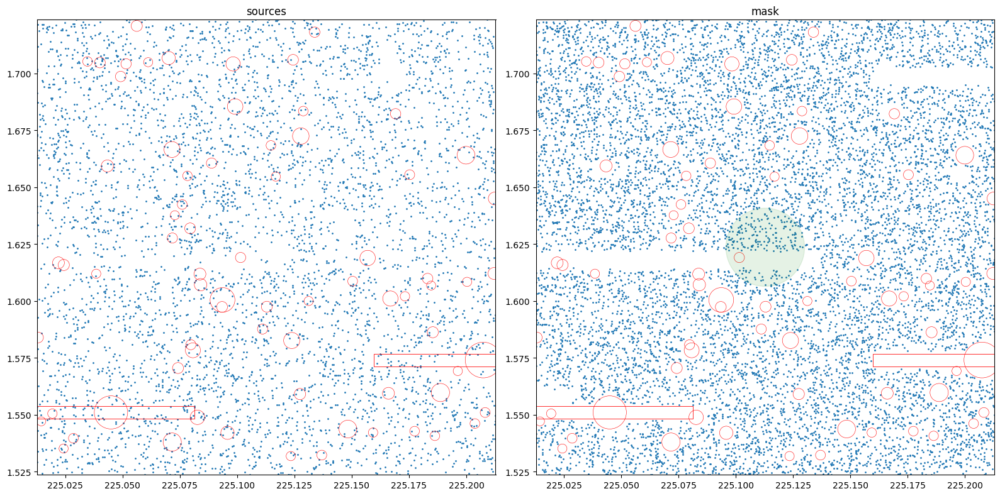

46 NGC7460 345.4287915 2.2635833 1.1402497875611686 12.598805202538504 36.663


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


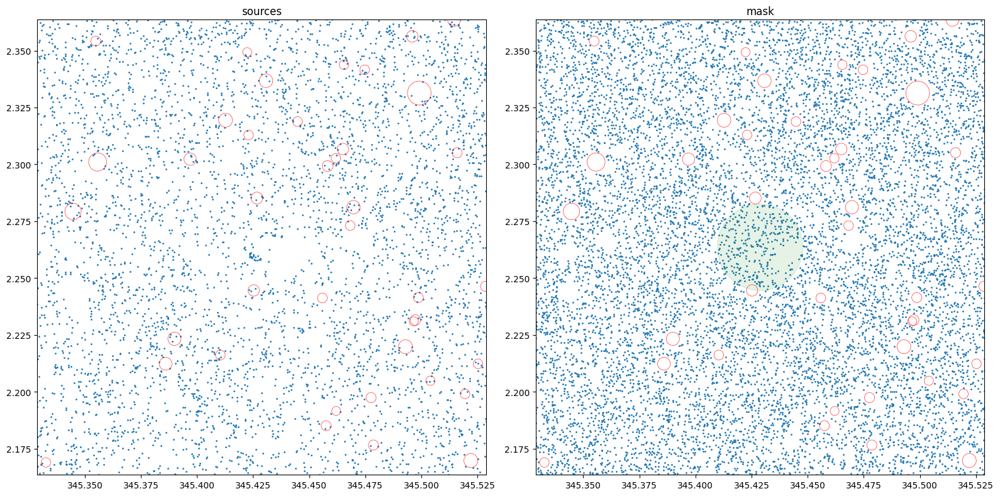

47 NGC7715 354.091722 2.1567864 2.0558905959841414 12.415627105744669 44.192


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


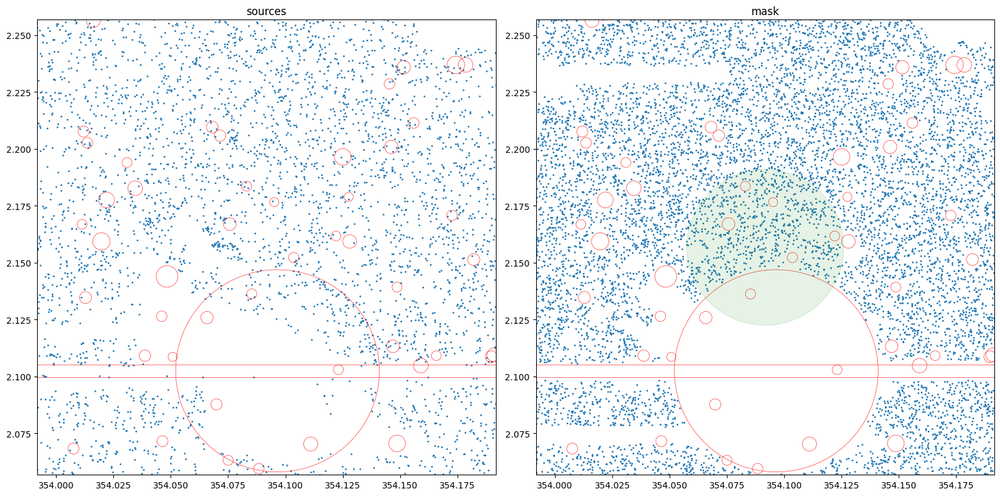

48 NGC7716 354.1310445 0.2972754 1.8323144223712111 11.992321610209164 22.576


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


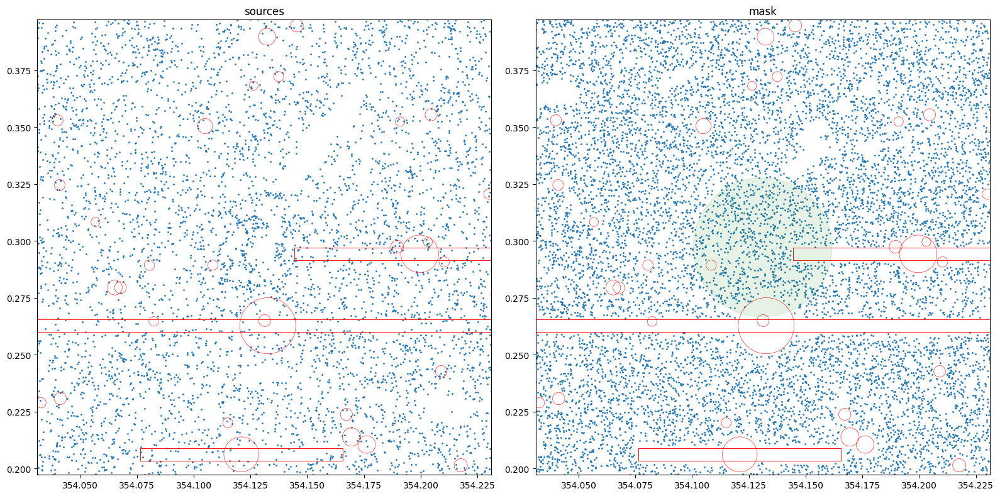

49 PGC004826 20.092041 1.8884444 0.5382697825162883 15.573491828181286 21.428


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


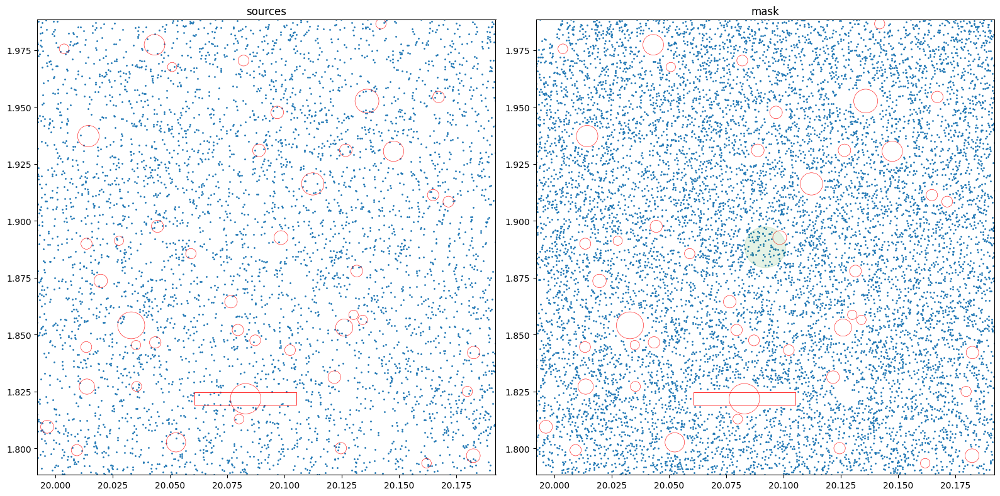

50 PGC005384 21.694056 -0.6460568 0.4560369159512962 15.945543438920982 8.62


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


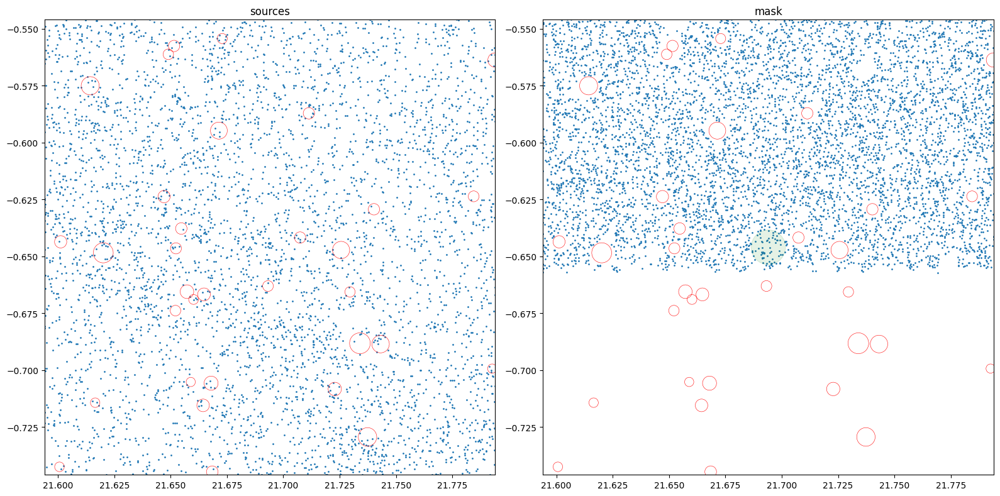

51 PGC007900 31.131066 -6.1989563 3.1117163371060186 13.675948867091751 32.825


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


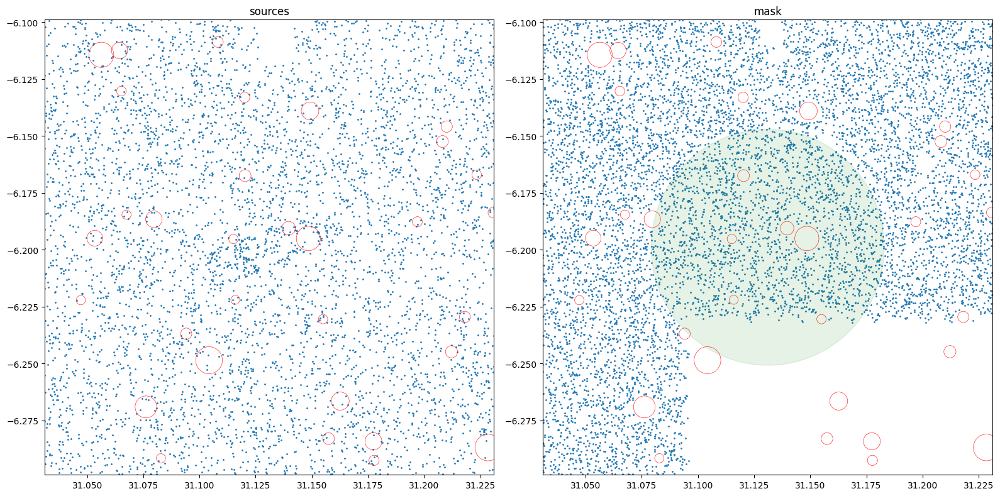

52 PGC008650 33.9812535 -2.015088 0.5011872336272722 15.084134267140136 19.918


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


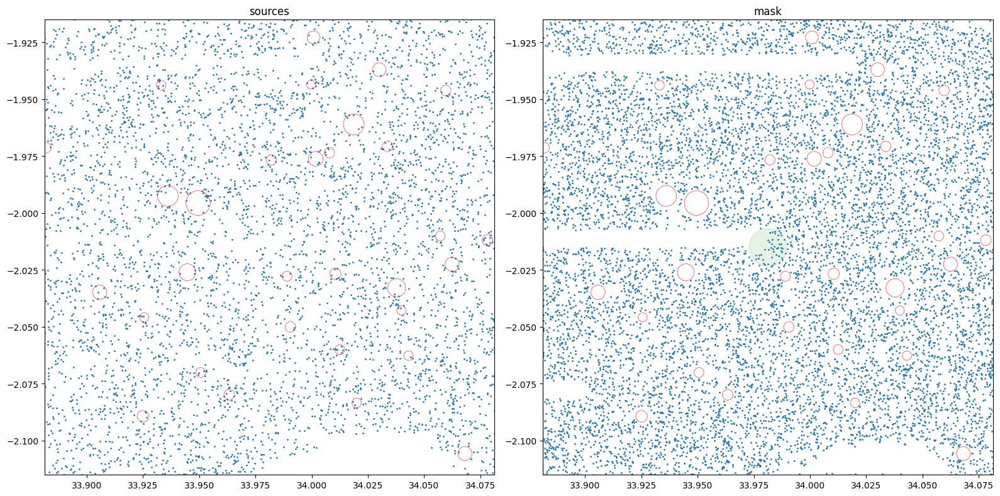

53 PGC008784 34.5337155 0.7583134 0.3872576449216172 16.76587107586377 21.086


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


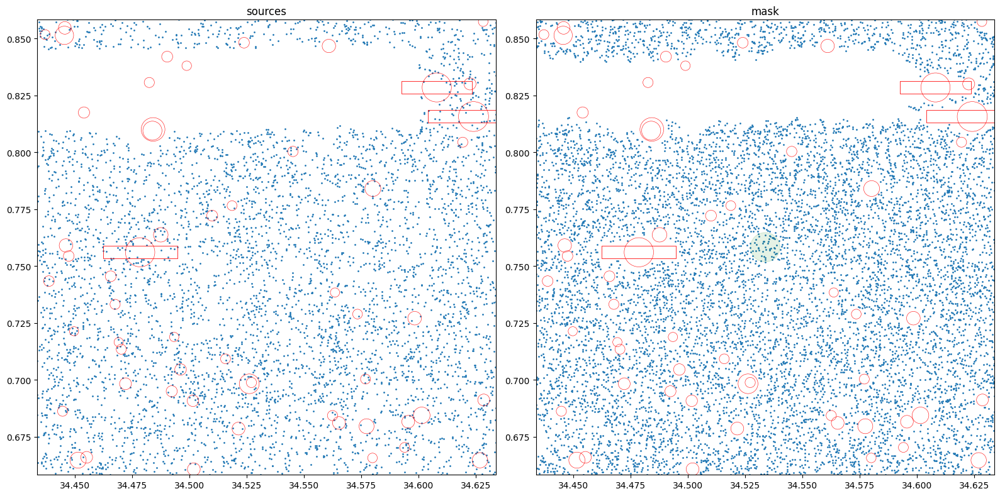

54 PGC008833 34.716333 -3.0409861 0.422668614265603 14.463515568944 44.574


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


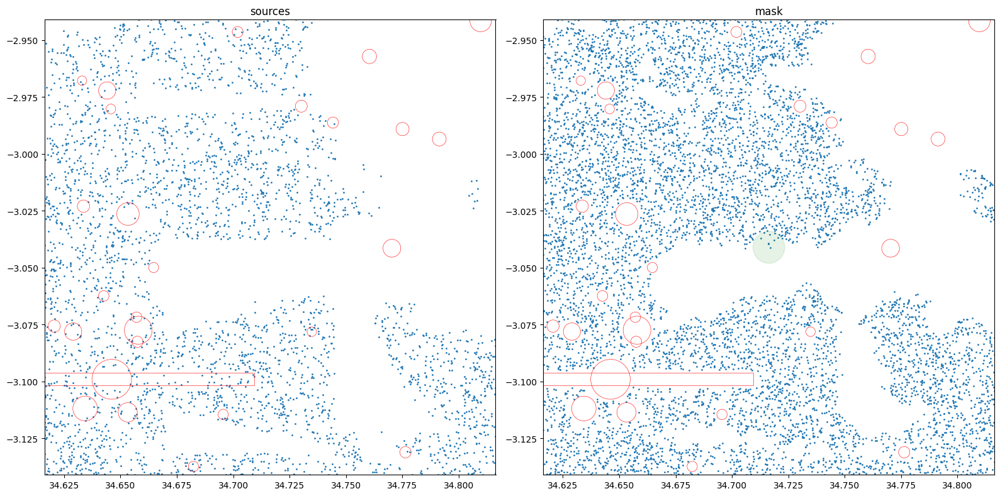

55 PGC009485 37.381848 -3.2129334 1.5170503674593367 12.738323545270234 38.387


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


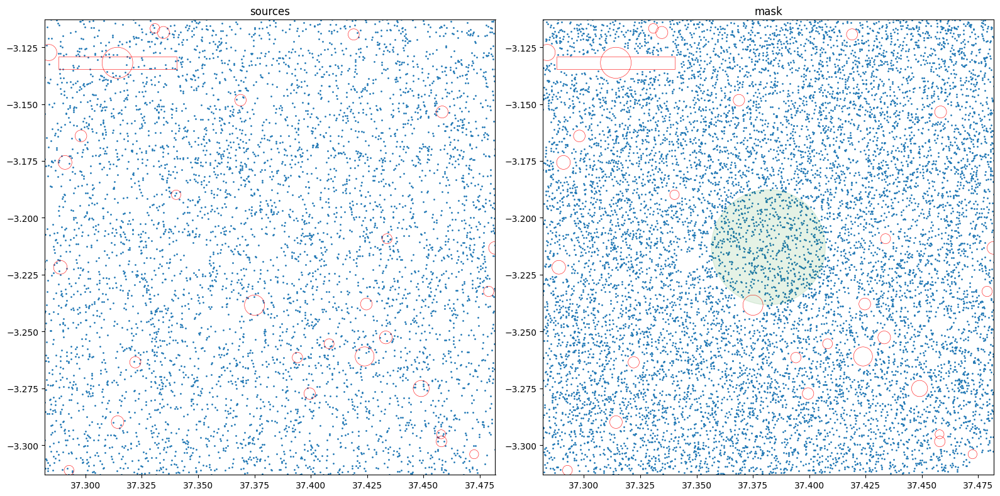

56 PGC009559 37.6721415 -3.8118722 1.3182567385564075 13.475582952808306 17.528


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


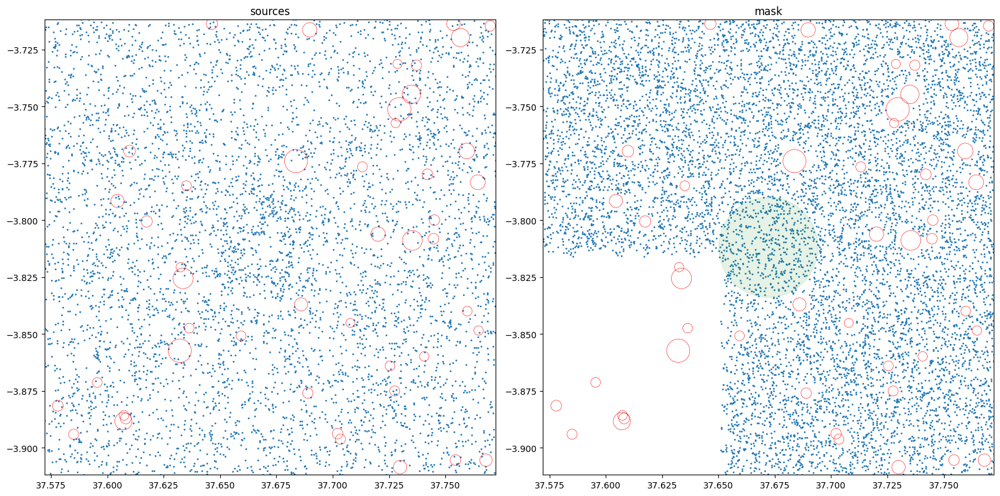

57 PGC027864 146.007894 -0.6422649 0.3917418771077831 15.90834598781025 23.979


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


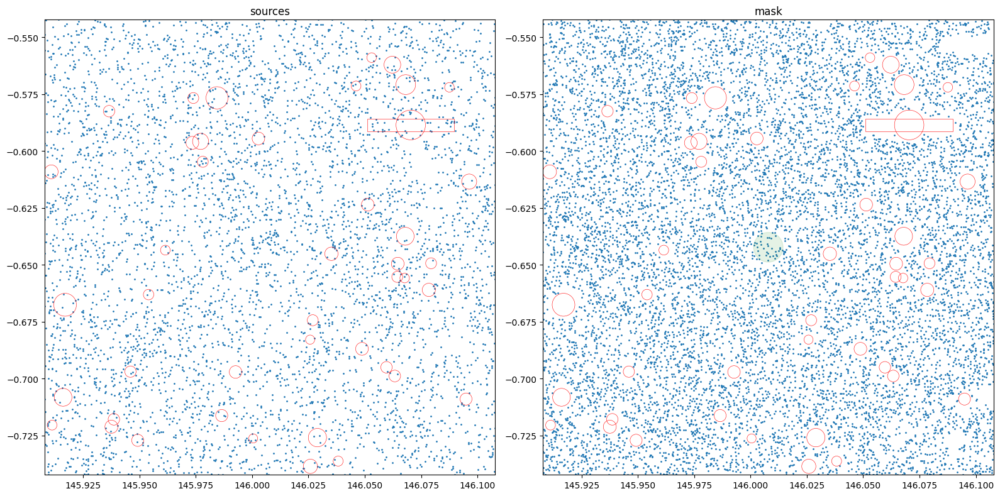

58 PGC030852 157.2002685 4.2342526 0.5152286445817564 15.841856591028044 41.503


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


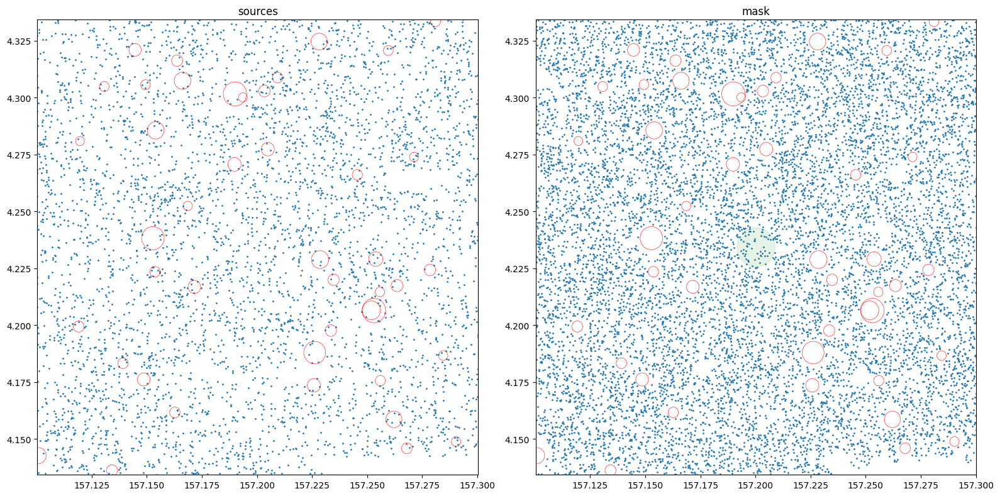

59 PGC032664 163.2026805 0.0345263 0.5011872336272722 15.295305223273232 23.579


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


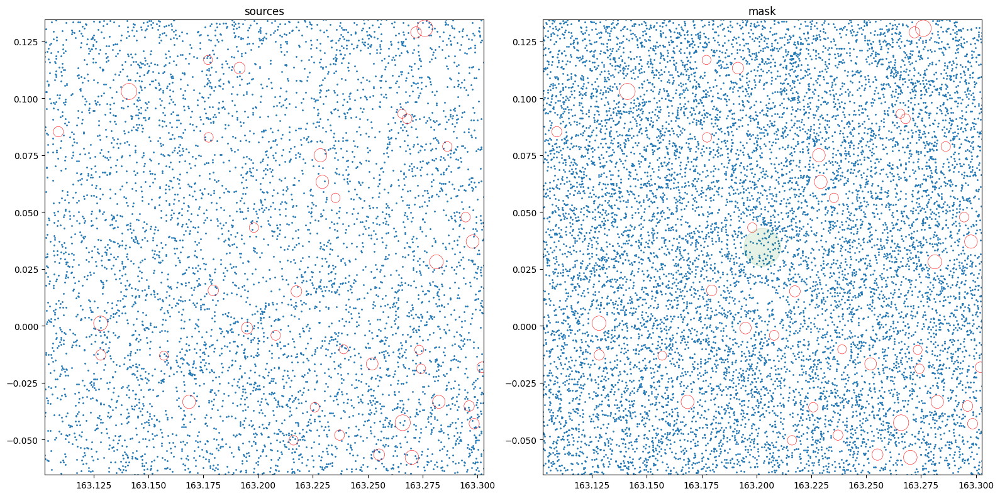

60 PGC034653 169.8882495 3.0148439 0.6165950018614822 15.277794107919625 25.913


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


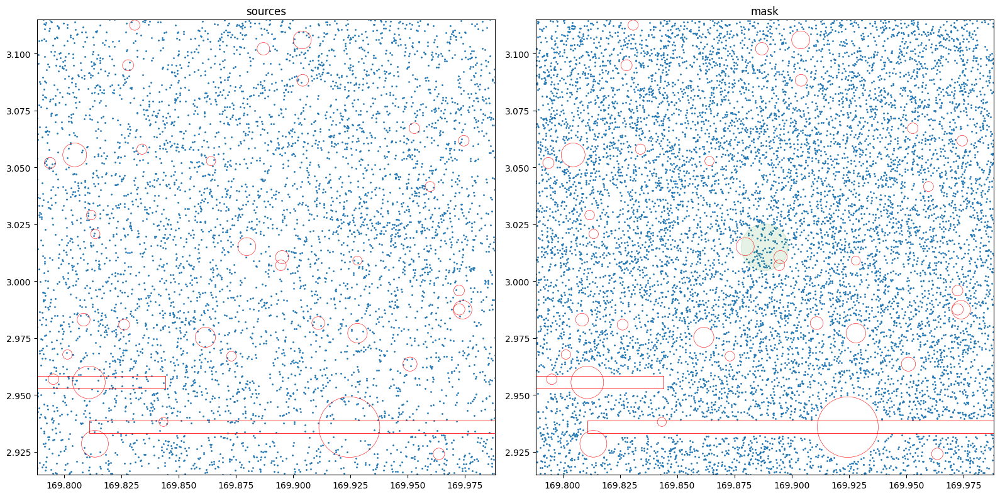

61 PGC036594 176.2261005 2.1631999 1.1748975549395297 16.30657176389634 40.654


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


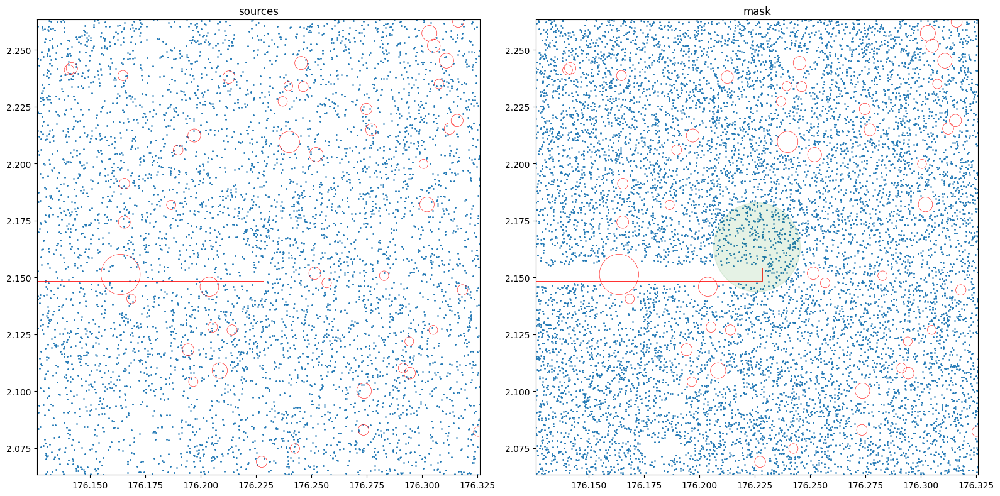

62 PGC036750 176.752995 -0.2941596 0.8491804750363139 14.725372189851718 25.308


/var/tmp/ipykernel_16978/2604318010.py:22: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')


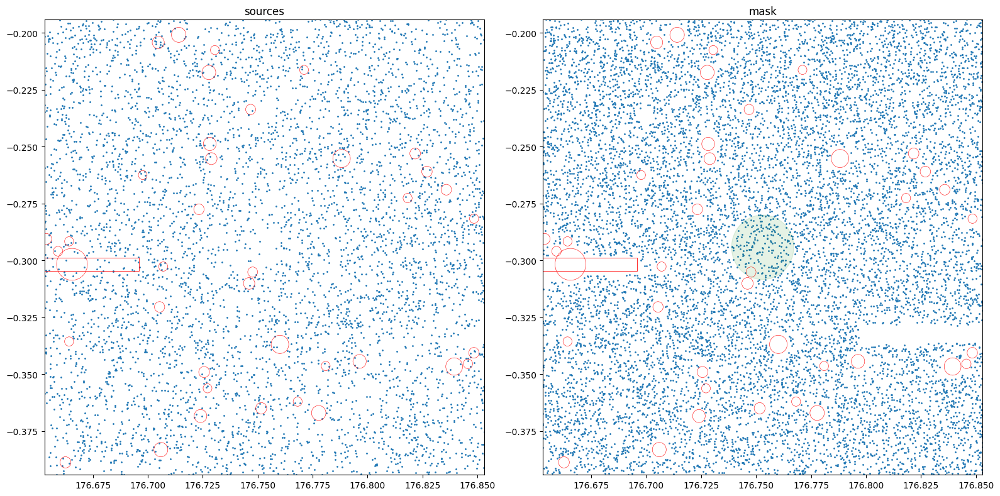

63 PGC037019 177.6514755 -0.567223 0.6902398038402419 14.93788482440884 34.072


In [ ]:
k = 0                # just an stupid counter
dist_cut = 50        # in Mpc 
angu_cut = 0.1       # in arcmin (same that the resolution of the mask)
imag_cut = 18        # magnitudes
half_size_plot = 0.1 # in degrees
#NSIDE=2**15
#plt.scatter(gal['ra_mag'], gal['dec_mag'], s=1, alpha=0.4)
for i in range(srcs_masked.shape[0]):
    # nearby_galax_df.iloc[58, i]=-2.5*np.log10(nearby_galax_df["i_lum_nsa"][i])+5*np.log10(nearby_galax_df["bestdist"][i]*1e6)
    # cheange HERE, using healsparce evaluation 
    #if mask[ang2pix(NSIDE, nearby_galax_df['ra'][i], nearby_galax_df['dec'][i], nest=True, lonlat=True)] == 1:
    
    if srcs_masked["bestdist"][i] < dist_cut:
            if srcs_masked["d25"][i] > angu_cut:
                if -2.5*np.log10(srcs_masked["i_lum_nsa"][i])+5*np.log10(srcs_masked["bestdist"][i]*1e6) < imag_cut: 
                    k=k+1
                    print(k, srcs_masked['objname'][i], srcs_masked['ra'][i], srcs_masked['dec'][i], srcs_masked["d25"][i],-2.5*np.log10(srcs_masked["i_lum_nsa"][i])+5*np.log10(srcs_masked["bestdist"][i]*1e6), nearby_galax_df["bestdist"][i])
                    xwin = [srcs_masked['ra'][i]-half_size_plot, srcs_masked['ra'][i]+half_size_plot]  # plot range in ra
                    ywin = [srcs_masked['dec'][i]-half_size_plot, srcs_masked['dec'][i]+half_size_plot]  # plot range in dec
                    
                    mkp.plot2compare(stage='mask', nr=200_000_000, s=1, figsize=[16,8], xwin=xwin, ywin=ywin, plot_stars=True, plot_boxes=True)
                    circle1 = plt.Circle((srcs_masked["ra"][i], srcs_masked["dec"][i]), srcs_masked["d25"][i]/60., color="g", clip_on=False, alpha=0.1, edgecolor='none')
                    plt.gca().add_patch(circle1)
                    plt.show()

(array([  7.,  16.,  53., 103.,  82.,  91.,  88.,  54.,  29.,  28.]),
 array([ 0.09  ,  5.3258, 10.5616, 15.7974, 21.0332, 26.269 , 31.5048,
        36.7406, 41.9764, 47.2122, 52.448 ]),
 <BarContainer object of 10 artists>)

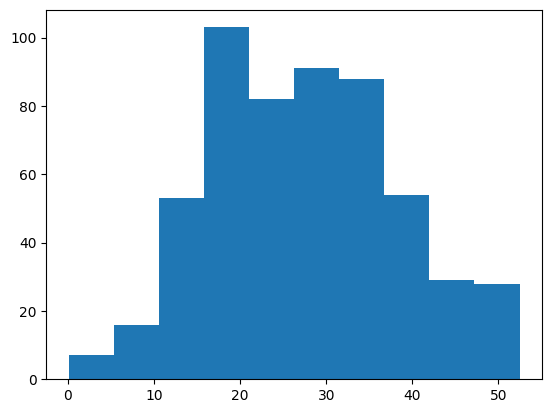

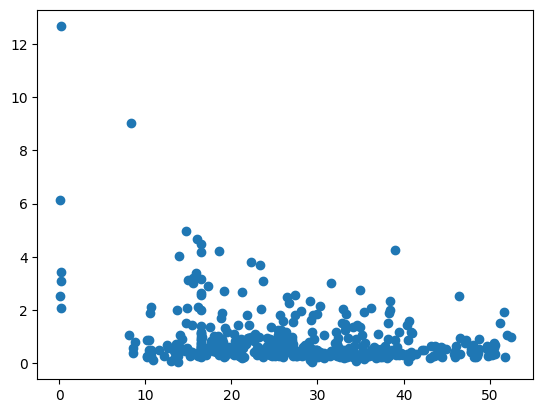

In [39]:
plt.scatter(srcs_masked["bestdist"],srcs_masked["d25"])
plt.show()

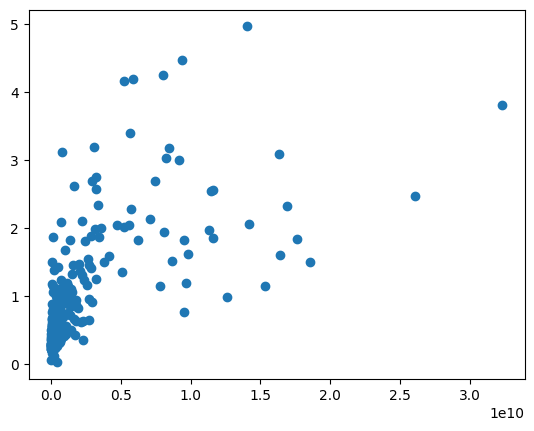

In [40]:
plt.scatter(srcs_masked["i_lum_nsa"],srcs_masked["d25"])
plt.show()

In [ ]:
# include satellites database incl